# SDAV Final Project: Socioeconomic factors and impact in London

In [ ]:
import pandas as pd
import numpy as np
import plotly.express as px
import json
import seaborn as sns
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = [10, 10]


# 1. Motivation.

       
    












## 1.1. What is your dataset?
Our dataset is a combination of seven datasets containing information about COVID-19 cases and vaccination, retail activity, mobility and neighborhood social status in London. The datasets used in this project are the ones that follow: 
<ul>
<li>PHE Cases Age London: This dataset contains information on COVID-19 daily cases divided by age groups in 5 year steps. Also, the population in each age group can be found in this database. </li>
<li>PHE Cases Boroughs London: In this database the daily cases in each London's neighborhood are included. For each borough it is included the name and code of the neighborhood, as well as the new cases per dya and total number of cases since the beginning of the pandemic</li>
<li>NHSE Weekly Vaccines London LTLA: Report by the NHS of the number of COVID-19 vaccinated people divided by residence area and age group. The dataset contains the number of doses that have been administered per day, as well as the percent of the population over the age of 16 who has been vaccinated for both only first dose and fully vaccinated.</li>
<li>Activity Retail: Since February 2020 all the activity divided in "Retail & Recreation", "Grocery & Pharmacy", "Reastaurant Bookings" and "Social" are registered in this dataset. The activity is measured in activity per day and change since the previous day. </li>
<li>Activity Transport: The number of people using the different transport means are listed here. The following means of transportation are considered: "Transit", "Journeys", "Transit stations" and "Public Transport" </li>
<li>Housing in London Monthly Variables: Contains various social and economic data for each London's neighborhood per year. Some of the data registered are the median salary, popluation and number of jobs among others.</li>
<li>Housing in London Monthly Variables: Centered around the housing market of London containing data about the average price house per area code in London every month.</li>
</ul>
All databases are extracted from the Official London Datastore (London DATASTORE, 2021).
Additionally, two other datasets have been used: London's geojson database to plot the maps and London Borough Profiles to know the population in each London's neighborhood.


##1.2 Why did you choose this/these particular dataset(s)

The main idea of the project was to analyse the socio-economical impact in the different areas in London. We also wanted to find out if there was any relation between the wealth and the number of cases and vaccination in each area. In order to achieve this goal information on pandemic indicators and socio-economic data during the COVID period were needed. The pandemic indicator databases contain basic information about the pandemic evolution that can be compared with the activity. Furthermore, one of the targets was to make a reliable analysis, therefore all the datasets have been obtained from the Official London Datastore. The datasets obtained are administered by the Greater London Authority [GLA], which is a strategic administration of London. From the webpage, raw data can be obtained for free. All data sources are supported with a reference to the original data source which strengthens the data credibility.

Also working with social activity and retail information, not only with pandemic indicators allowed us to **offer an application** for bussiness in order to **assess competitive areas** during the pandemic or predict the affluence for a particular retail of a particular borough.

## 1.3. What was your goal for the end user's experience?
The main goal is to give an overall idea of the COVID-19 socio-economic impact in London. However, the most interesing feature of the project is to provide a predictive model that calculates which type of business will perform better depending on the COVID-19 risk level. We also want to give an understanding of how the lockdowns and restrictions have affected to businesses, mobility and social activity. The information accessible on the webpage can be applied for several purposes. For instance, a new business owner or an expanding business owner can compare the governmental restrictions to consumer behaviour. The business owner can gain insights to how quickly restrictions are affected in behaviour and once restriction are lifted how quick consumers gain confidence in mobility and social activity. Also, new business owners can get an idea on whhich are would be the best to set their new business depending on the COVID level
\
In order to ahieve this, a webpage with various visualizations has been created, such as the COVID-19 cases evolution, London maps with the incidence per area, a graph comparing the daily cases with different transportation measurements, among others. Also, a model where the user can enter COVID level and area and shows the performance of each kind of business is included. All visualizations are interactive and contain different design space analysis tools in order to give a clear insight to the final user.

# 2. Data sets loading and merging:

Schematizing what has been exposed into Point 1, the overall Dataset consist on:

*  Covid progress
  * Weekly vaccinations
  * PHE cases Age
  * PHE cases boroughs

*  Social activity covid-period:
  * Activity Retail
  * Activity Transport

*  Social indicators:
  * Housing monthly variables
  * Yearly variables

## 2.1 Write about your choices in data cleaning and preprocessing

First state  that our data cleaning and preprocessing/merge process has been **heavy**, implying considerable amounts of coding time and decisions. That is due to many reasons, that are exposed through the following sections, but mainly because we combine 7 diferent datasets, differtly confected and labeled, with diferent date range entries. The reasons behind this have been Nevertheless, also notice that having a good final merged dataset allowed us to have a good structured and matched dataset for the posterior parts, being able to fast queying.

## Raw datasets overview

### COVID Cases

In [ ]:
phe_cases_age = pd.read_csv('phe_cases_age_london.csv')
phe_cases_age.head(n =1)

,area_name,area_code,date,age_band,age_lower,age_higher,cases,rolling_rate,rolling_sum,population
0,London,E12000007,2020-01-30,0 - 4 years,0.0,4.0,0,0.0,0,606004.0


In [ ]:
phe_cases_boroughs = pd.read_csv('phe_cases_london_boroughs.csv')
phe_cases_boroughs.head(n =1)

,area_name,area_code,date,new_cases,total_cases
0,Barking and Dagenham,E09000002,2020-02-11,0,0


### COVID Vaccinations

In [ ]:
vacinations = pd.read_csv('nhse_weekly_vaccines_london_ltla.csv')
vacinations.end_date.unique()

array(['2021-02-21', '2021-02-28', '2021-03-07', '2021-03-14',
       '2021-03-21', '2021-03-28', '2021-04-04', '2021-04-11',
       '2021-04-18', '2021-04-25', '2021-05-02'], dtype=object)

### Social Activity 

In [ ]:
activity_by_borough = pd.read_csv('google_activity_by_London_Borough.csv')
activity_by_borough.head(n =1)

,date,area_name,area_code,retail_and_recreation_percent_change_from_baseline,grocery_and_pharmacy_percent_change_from_baseline,parks_percent_change_from_baseline,transit_stations_percent_change_from_baseline,workplaces_percent_change_from_baseline,residential_percent_change_from_baseline
0,2020-02-15,City of London,E09000001,-5.0,-9.0,-12.0,-11,NaN,NaN


In [ ]:
activity_retail = pd.read_csv('activity_retail.csv')
activity_retail.tail(n =1)

,location,activity,date,change,value,source,roll
1324,Greater London,Social,2020-12-09,-71.810131,28.189869,Purple,29.955309


In [ ]:
activity_retail.activity.unique()

array(['Retail & recreation', 'Grocery & pharmacy', 'Restaurant bookings',
       'Social'], dtype=object)

In [ ]:
activity_transport = pd.read_csv('activity_transport.csv')
activity_transport.head(n =1)

,date,activity,value,roll,source
0,2020-03-08,transit,100.86,109.927143,Apple


### Other social indicator: Housing

In [ ]:
housing_month = pd.read_csv('housing_in_london_monthly_variables.csv')
housing_month.head(n =1)

,date,area,average_price,code,houses_sold,no_of_crimes,borough_flag
0,1995-01-01,city of london,91449,E09000001,17.0,NaN,1


In [ ]:
housing_yearly = pd.read_csv('housing_in_london_yearly_variables.csv')
housing_yearly.head(n =1)

,code,area,date,median_salary,life_satisfaction,mean_salary,recycling_pct,population_size,number_of_jobs,area_size,no_of_houses,borough_flag
0,E09000001,city of london,1999-12-01,33020.0,NaN,48922,0,6581.0,NaN,NaN,NaN,1


## Pretreatment


This project has required a **heavy preprocessing** in order to merge all the features presented in a sensefull way.


#### Merging introduction

The datasets merge is pivoted on basis on the **merging-features Date and Borough**, which are the common coulmns (in different combinations as shown bellow) between the different datasets. 


| Covid progress   | Date  | Borough  | Age Band  
|---|---|---|---|
| **Weekly vaccinations**   | start_date  | ltla_code | age_band [eg. 0-4]
| **PHE cases Age**  | date | area_code | age_band [eg. 0 - 4 years]
| **PHE cases boroughs**  | date  |  area_code |  

---

| Activity reports   | Date  | Borough  | 
|---|---|---|
| **Activity Retail**   | date  |  
| **Activity Transport**  | date |   
| **Activity Retail, Transport and Remote/presential work**  | date |  	area_code

---

| Social indicators   | Date  | Borough  
|---|---|---|
| **Housing monthly variables**   | start_date | code
| **Housing yearly variables**  |  | code

---


#### Renaming columns

In order to allow propper merge on merging features all should be labeled the same way.

In [ ]:
phe_cases_age = phe_cases_age.rename(columns={"cases": "daily_cases_by_age","population":"population_by_age"})
phe_cases_boroughs = phe_cases_boroughs.rename(columns={"total_cases": "total_cases_by_borough", "new_cases":"daily_cases_by_borough"})

vacinations = vacinations.rename(columns={"vaccines":"number_vaccines","end_date": "date", "ltla_code": "area_code", "age_band":"age_band_vaccines"})


activity_transport = activity_transport.rename(columns={"activity": "activity_transport", "value":"transport_value"})
activity_retail = activity_retail.rename(columns={"activity": "activity_retail", "change":"retail_change"})
activity_by_borough = activity_by_borough.rename(columns={"retail_and_recreation_percent_change_from_baseline": "retail_and_recreation_change", 
                                                          "grocery_and_pharmacy_percent_change_from_baseline":"grocery_and_pharmacy_change",
                                                          "transit_stations_percent_change_from_baseline":"transit_stations_change",
                                                          "workplaces_percent_change_from_baseline":"workplaces_percent_change",
                                                          "residential_percent_change_from_baseline":"residential_percent_change"})

housing_yearly = housing_yearly.rename(columns={"code": "area_code","mean_salary":"mean_salary_borough", "median_salary":"median_salary_borough"})
housing_month = phe_cases_boroughs.rename(columns={"start_date": "date", "code": "area_code"})

Then now having: 


| Covid progress   | Date  | Borough  | Age Band  
|---|---|---|---|
| **Weekly vaccinations**   | date  | area_code | age_band_vaccines  [eg. 0-4]
| **PHE cases Age**  | date | area_code | age_band [eg. 0 - 4 years] & age_band_vaccines  [eg. 0-4]
| **PHE cases boroughs**  | date  |  area_code |  

---

| Activity reports   | Date  | Borough  | 
|---|---|---|
| **Activity Retail**   | date  |  
| **Activity Transport**  | date |   
| **Activity Retail, Transport and Remote/presential work**  | date |  	area_code

---

| Social indicators   | Date  | Borough  
|---|---|---|
| **Housing monthly variables**   | date | code
| **Housing yearly variables**  |  | code

---

### Filter relevant columns

In [ ]:
phe_cases_age = phe_cases_age.drop(['area_name','rolling_rate','rolling_sum'],axis=1)
phe_cases_boroughs = phe_cases_boroughs.drop(['area_name'],axis=1)

phe_cases_age.head(n=1)

,area_code,date,age_band,age_lower,age_higher,daily_cases_by_age,population_by_age
0,E12000007,2020-01-30,0 - 4 years,0.0,4.0,0,606004.0


In [ ]:
phe_cases_boroughs.head(n=1)

,area_code,date,daily_cases_by_borough,total_cases_by_borough
0,E09000002,2020-02-11,0,0


**CASES-VACINATIONS** / **TO DISCUSS**

*   **Doses_information** is excluded, also **end_date**, and **ltla_name is associated to housing**. 
*   We consider **percent_vaccine** which contains **population** and **vacine_amount**.



In [ ]:
vacinations

,ltla_name,area_code,start_date,date,dose,age_band_vaccines,number_vaccines,population,percent_vaccine
0,Barking and Dagenham,E09000002,2020-12-08,2021-02-21,1st dose,70-74,4059,4836,0.839330
1,Barnet,E09000003,2020-12-08,2021-02-21,1st dose,70-74,12806,14410,0.888688
2,Bexley,E09000004,2020-12-08,2021-02-21,1st dose,70-74,9800,10250,0.956098
3,Brent,E09000005,2020-12-08,2021-02-21,1st dose,70-74,7961,9845,0.808634
4,Bromley,E09000006,2020-12-08,2021-02-21,1st dose,70-74,14478,15383,0.941169
...,...,...,...,...,...,...,...,...,...
3163,Sutton,E09000029,2020-12-08,2021-05-02,2nd dose,Under 45,8530,77418,0.110181
3164,Tower Hamlets,E09000030,2020-12-08,2021-05-02,2nd dose,Under 45,9773,183940,0.053131
3165,Waltham Forest,E09000031,2020-12-08,2021-05-02,2nd dose,Under 45,7292,123788,0.058907
3166,Wandsworth,E09000032,2020-12-08,2021-05-02,2nd dose,Under 45,12290,173509,0.070832


In [ ]:
vacinations['number_vaccines'].sum()

34533454

In [ ]:
vacinations[vacinations.date=='2021-02-21']['number_vaccines'].sum()

1746338

In [ ]:
vacinations[vacinations.date=='2021-05-02']['number_vaccines'].sum()

5150656

In [ ]:
vacinations_1stdose = vacinations[vacinations['dose']=='1st dose']
vacinations_1stdose

,ltla_name,area_code,start_date,date,dose,age_band_vaccines,number_vaccines,population,percent_vaccine
0,Barking and Dagenham,E09000002,2020-12-08,2021-02-21,1st dose,70-74,4059,4836,0.839330
1,Barnet,E09000003,2020-12-08,2021-02-21,1st dose,70-74,12806,14410,0.888688
2,Bexley,E09000004,2020-12-08,2021-02-21,1st dose,70-74,9800,10250,0.956098
3,Brent,E09000005,2020-12-08,2021-02-21,1st dose,70-74,7961,9845,0.808634
4,Bromley,E09000006,2020-12-08,2021-02-21,1st dose,70-74,14478,15383,0.941169
...,...,...,...,...,...,...,...,...,...
2875,Sutton,E09000029,2020-12-08,2021-05-02,1st dose,Under 45,21730,77418,0.280684
2876,Tower Hamlets,E09000030,2020-12-08,2021-05-02,1st dose,Under 45,39557,183940,0.215054
2877,Waltham Forest,E09000031,2020-12-08,2021-05-02,1st dose,Under 45,29069,123788,0.234829
2878,Wandsworth,E09000032,2020-12-08,2021-05-02,1st dose,Under 45,42657,173509,0.245849


In [ ]:
vacinations_1stdose['number_vaccines'].sum()

31667685

In [ ]:
phe_cases_age.age_band.unique()

array(['0 - 4 years', '5 - 9 years', '10 - 14 years', '15 - 19 years',
       '20 - 24 years', '25 - 29 years', '30 - 34 years', '35 - 39 years',
       '40 - 44 years', '45 - 49 years', '50 - 54 years', '55 - 59 years',
       '60 - 64 years', '65 - 69 years', '70 - 74 years', '75 - 79 years',
       '80 - 84 years', '85 - 89 years', '90+ years', 'unassigned'],
      dtype=object)

In [ ]:
vacinations.age_band_vaccines.unique() #Deal 'Under' and range

array(['70-74', '75-79', '80+', 'Under 70', '65-69', 'Under 65', '60-64',
       'Under 60', '55-59', 'Under 55', '50-54', 'Under 50', '45-49',
       'Under 45'], dtype=object)

We set lower and upper range for lower than 50 as a list. **?**: Just adding '45 - 49 years' for now.


In [ ]:
age_band_vacination_to_cases = {'70-74': '70 - 74 years', 
                                '75-79': '75 - 79 years', 
                                '80+': '80 - 84 years', 
                                'Under 70': '65 - 69 years', 
                                '65-69': '65 - 69 years', 
                                'Under 65': '55 - 59 years', 
                                '60-64': '60 - 64 years',
                                'Under 60': '55 - 59 years', # Divide or what?
                                '55-59': '55 - 59 years', 
                                'Under 55': '50 - 54 years',
                                '50-54': '50 - 54 years',
                                'Under 50': '50 - 54 years',
                                '45-49': '45 - 49 years',
                                'Under 45': '40 - 44 years',
                                }

In [ ]:
age_band_cases_to_vacinations = {'0 - 4 years':'Under 45', 
                                '5 - 9 years':'Under 45',
                                '10 - 14 years':'Under 45',
                                '15 - 19 years':'Under 50',
                                '20 - 24 years':'Under 55',
                                '25 - 29 years':'Under 60',
                                '30 - 34 years':'Under 65',
                                '35 - 39 years':'Under 70',
                                '40 - 44 years':'45-49', 
                                '45 - 49 years':'45-49',
                                '50 - 54 years':'50-54',
                                '55 - 59 years':'55-59',
                                '60 - 64 years':'60-64',
                                '65 - 69 years':'65-69',
                                '70 - 74 years':'70-74',
                                '75 - 79 years':'75-79',
                                '80 - 84 years':'80+',
                                '85 - 89 years':'80+',
                                '90+ years':'80+',
                                'unassigned':'Under 50'
                                }

From the mapping we add **age_lower** and	**age_higher** columns:

In [ ]:
vacinations.head(n=1)

,ltla_name,area_code,start_date,date,dose,age_band_vaccines,number_vaccines,population,percent_vaccine
0,Barking and Dagenham,E09000002,2020-12-08,2021-02-21,1st dose,70-74,4059,4836,0.83933


In [ ]:
vacinations = vacinations.drop(['start_date','ltla_name','population'],axis=1)

vacinations.head(n=1)

,area_code,date,dose,age_band_vaccines,number_vaccines,percent_vaccine
0,E09000002,2021-02-21,1st dose,70-74,4059,0.83933


In [ ]:
phe_cases_age['age_band_vaccines'] = phe_cases_age['age_band'].map(age_band_cases_to_vacinations)
phe_cases_age

,area_code,date,age_band,age_lower,age_higher,daily_cases_by_age,population_by_age,age_band_vaccines
0,E12000007,2020-01-30,0 - 4 years,0.0,4.0,0,606004.0,Under 45
1,E12000007,2020-01-30,5 - 9 years,5.0,9.0,0,602992.0,Under 45
2,E12000007,2020-01-30,10 - 14 years,10.0,14.0,0,537605.0,Under 45
3,E12000007,2020-01-30,15 - 19 years,15.0,19.0,0,467602.0,Under 50
4,E12000007,2020-01-30,20 - 24 years,20.0,24.0,0,565427.0,Under 55
...,...,...,...,...,...,...,...,...
9255,E12000007,2021-05-06,75 - 79 years,75.0,79.0,2,193310.0,75-79
9256,E12000007,2021-05-06,80 - 84 years,80.0,84.0,1,150816.0,80+
9257,E12000007,2021-05-06,85 - 89 years,85.0,89.0,0,93461.0,80+
9258,E12000007,2021-05-06,90+ years,90.0,90.0,0,57456.0,80+


Since the vaccinations are only weekly reported, there are only one entry per week. We **infer for all the week the entries from the previous.**

In [ ]:
vacc_date = vacinations.date.unique()
vacc_date

array(['2021-02-21', '2021-02-28', '2021-03-07', '2021-03-14',
       '2021-03-21', '2021-03-28', '2021-04-04', '2021-04-11',
       '2021-04-18', '2021-04-25', '2021-05-02'], dtype=object)

In [ ]:
import datetime

for idx in range(len(vacc_date)-1):
    date = vacc_date[idx]
    
    date1 = datetime.datetime.strptime(date, "%Y-%m-%d").date()
    date2 = datetime.datetime.strptime(vacc_date[idx+1], "%Y-%m-%d").date()
    day = datetime.timedelta(days=1)
    
    for j in range((date2 - date1).days): 
        date_j = date1 + datetime.timedelta(days=j)

        if j == 0:
            rows = vacinations[vacinations.date==str(date_j)]
        else:
            rows['date'] = str(date_j)

        if idx == 0 and j == 0:
            vacinations_daily = rows
        else:
            vacinations_daily  = pd.concat([vacinations_daily, rows])

rows = vacinations[vacinations.date=='2021-05-02'] 
rows['date'] = '2021-05-02'    
vacinations_daily  = pd.concat([vacinations_daily, rows])       

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
vacinations_daily.date.unique()

array(['2021-02-22', '2021-02-23', '2021-02-24', '2021-02-25',
       '2021-02-26', '2021-02-27', '2021-02-28', '2021-03-01',
       '2021-03-02', '2021-03-03', '2021-03-04', '2021-03-05',
       '2021-03-06', '2021-03-07', '2021-03-08', '2021-03-09',
       '2021-03-10', '2021-03-11', '2021-03-12', '2021-03-13',
       '2021-03-14', '2021-03-15', '2021-03-16', '2021-03-17',
       '2021-03-18', '2021-03-19', '2021-03-20', '2021-03-21',
       '2021-03-22', '2021-03-23', '2021-03-24', '2021-03-25',
       '2021-03-26', '2021-03-27', '2021-03-28', '2021-03-29',
       '2021-03-30', '2021-03-31', '2021-04-01', '2021-04-02',
       '2021-04-03', '2021-04-04', '2021-04-05', '2021-04-06',
       '2021-04-07', '2021-04-08', '2021-04-09', '2021-04-10',
       '2021-04-11', '2021-04-12', '2021-04-13', '2021-04-14',
       '2021-04-15', '2021-04-16', '2021-04-17', '2021-04-18',
       '2021-04-19', '2021-04-20', '2021-04-21', '2021-04-22',
       '2021-04-23', '2021-04-24', '2021-04-25', '2021-

In [ ]:
vacinations = vacinations_daily

**SOCIAL ACTIVITY** 

In [ ]:
activity_transport.head(n=1)

,date,activity_transport,transport_value,roll,source
0,2020-03-08,transit,100.86,109.927143,Apple


We need **transport_change instead of transpor_value** in order to match with other activity kinds that are measured by **change**.

In [ ]:
activity_retail.head(n=2)

,location,activity_retail,date,retail_change,value,source,roll
0,Greater London,Retail & recreation,2020-02-27,0.0,100.0,Google,99.428571
1,Greater London,Grocery & pharmacy,2020-02-27,-1.0,99.0,Google,99.714286


We identify as the **baseline value 100.0 where the change is 0.0**

In [ ]:
baseline = 100
activity_transport['transport_change'] = activity_transport['transport_value'] - baseline
activity_transport.head(n=2)

,date,activity_transport,transport_value,roll,source,transport_change
0,2020-03-08,transit,100.86,109.927143,Apple,0.86
1,2020-03-09,transit,98.05,109.257143,Apple,-1.95


We remove now the irrelevant columns, such as source, and to be **consistent** the metric is set as "**change**" on all columns relative to activity.

In [ ]:
activity_retail = activity_retail.drop(['location','source','roll','value'],axis=1)
activity_transport = activity_transport.drop(['source','roll','transport_value'],axis=1)

In [ ]:
activity_retail.head(n=1)

,activity_retail,date,retail_change
0,Retail & recreation,2020-02-27,0.0


In [ ]:
activity_transport.head(n=1)

,date,activity_transport,transport_change
0,2020-03-08,transit,0.86


We exlude park measurements from our analysis in the by borough DataSet.

In [ ]:
activity_by_borough=activity_by_borough.drop('parks_percent_change_from_baseline',axis=1)
activity_by_borough.head(n=1)

,date,area_name,area_code,retail_and_recreation_change,grocery_and_pharmacy_change,transit_stations_change,workplaces_percent_change,residential_percent_change
0,2020-02-15,City of London,E09000001,-5.0,-9.0,-11,NaN,NaN


**HOUSING** 

Area name (**area**) is handled by area in housing_yearly, and about the social metrics we only care about 'median_salary' and 'mean_salary'.

In [ ]:
housing_yearly =  pd.DataFrame(housing_yearly, columns=['date', 'area_code','area', 'median_salary_borough', 'mean_salary_borough'])
housing_yearly.head()

,date,area_code,area,median_salary_borough,mean_salary_borough
0,1999-12-01,E09000001,city of london,33020.0,48922
1,1999-12-01,E09000002,barking and dagenham,21480.0,23620
2,1999-12-01,E09000003,barnet,19568.0,23128
3,1999-12-01,E09000004,bexley,18621.0,21386
4,1999-12-01,E09000005,brent,18532.0,20911


#### Social Activity merge

Due to 2 **DataSets** of relevant social activity are out-to-date, a special pretreatment is done, infering the information from the 3th updated **DataSet**. Then for the 3 **DataSets** on **Social Activity** the different presented dates limits are as following exposed:

*   **Activity Retail for all city**:

In [ ]:
activity_retail.date.max()

'2021-02-09'

In [ ]:
activity_retail.head(n=1)

,activity_retail,date,retail_change
0,Retail & recreation,2020-02-27,0.0


In [ ]:
activity_retail.activity_retail.unique()

array(['Retail & recreation', 'Grocery & pharmacy', 'Restaurant bookings',
       'Social'], dtype=object)

*   **Activity Transport for all city**:

In [ ]:
activity_transport.date.max()

'2021-03-21'

In [ ]:
activity_transport.head(n=1)

,date,activity_transport,transport_change
0,2020-03-08,transit,0.86


In [ ]:
activity_transport.activity_transport.unique()

array(['transit', 'Journeys', 'Transit stations', 'public transport'],
      dtype=object)

*   **Activity counts variation by neighbours**: This correspond to the updated dataset, it can serve as a mesurement for imputing in other dates based on the baseline and relative change. 

In [ ]:
activity_by_borough.date.max()

'2021-05-04'

In [ ]:
activity_by_borough.head(n=1)

,date,area_name,area_code,retail_and_recreation_change,grocery_and_pharmacy_change,transit_stations_change,workplaces_percent_change,residential_percent_change
0,2020-02-15,City of London,E09000001,-5.0,-9.0,-11,NaN,NaN


It is noticed that no entry in **by_borough** corresponds to '**Greater London'**, thus the dataset has no entry labeled as in the previous dataset with such values for the overall city. The **step 1** planned below is preformed in order to do so.

In [ ]:
activity_by_borough.area_name.unique()

array(['City of London', 'Westminster', 'Barking and Dagenham', 'Barnet',
       'Bexley', 'Brent', 'Bromley', 'Camden', 'Croydon', 'Ealing',
       'Enfield', 'Hackney', 'Hammersmith and Fulham', 'Haringey',
       'Harrow', 'Havering', 'Hillingdon', 'Hounslow', 'Islington',
       'Lambeth', 'Lewisham', 'Merton', 'Newham', 'Redbridge',
       'Richmond upon Thames', 'Southwark', 'Sutton', 'Tower Hamlets',
       'Waltham Forest', 'Wandsworth', 'Greenwich',
       'Kensington and Chelsea', 'Kingston upon Thames'], dtype=object)

The following steps are performed to infer the values on the recent dates on the previous 2 datasets by the values on the 3th one:

##### 1.Extract the **mean** of the **percent_change_from_baseline** values on the whole city from the **by_borough** Dataset, grouping by date discarting the borough information.

In [ ]:
activity_all_london = activity_by_borough.groupby(by="date").mean()
activity_all_london.tail(n=2)

,retail_and_recreation_change,grocery_and_pharmacy_change,transit_stations_change,workplaces_percent_change,residential_percent_change
date,,,,,
2021-05-03,-32.666667,-15.454545,-63.969697,-77.363636,22.75
2021-05-04,-37.939394,-3.121212,-47.242424,-47.333333,15.75


##### 2.Retrieve the **baseline**, from which then the relative  value from the correspondent **out-of-date Datasets**:

|  Column in activity_change_greater_london  | Column in activity_retail  | Column in activity_transport  | 
|---|---|---|
| **retail_and_recreation_percent_change_from_baseline**   | 'Retail & recreation' 'Restaurant bookings' 'Social' |  
| **grocery_and_pharmacy_percent_change_from_baseline**  | 'Grocery & pharmacy' | 
| **transit_stations_percent_change_from_baseline**  |  | 'transit', 'Journeys', 'Transit stations', 'public transport'
      


In [ ]:
activity_all_london.head(n=2)

,retail_and_recreation_change,grocery_and_pharmacy_change,transit_stations_change,workplaces_percent_change,residential_percent_change
date,,,,,
2020-02-15,-9.757576,-6.818182,-7.909091,-2.46875,2.187500
2020-02-16,-10.575758,-10.878788,-9.545455,-3.93750,1.580645


In [ ]:
activity_all_london['date'] = activity_all_london.index
activity_all_london = activity_all_london.reset_index(drop=True)

In [ ]:
activity_all_london_transit_last_period = activity_all_london[(activity_all_london['date'] > '2021-03-21')]
activity_all_london_transit_for_transit_stations = activity_all_london[(activity_all_london['date'] > '2021-02-09') & (activity_all_london['date'] < '2021-03-22')]

activity_all_london_retail_last_period = activity_all_london[(activity_all_london['date'] > '2021-02-09')]
activity_all_london_grocery_last_period = activity_all_london[(activity_all_london['date'] > '2021-02-01')]

##### 3. **Concat** missing dates rows on the 2 other sets

Hereby since our Data analysis is **based bastly on activity records** an **extended subpreprocessing** is hereby performed.

**ACTIVITY RETAIL**


In [ ]:
activity_all_london_retail_last_period.head(n=1)

,retail_and_recreation_change,grocery_and_pharmacy_change,transit_stations_change,workplaces_percent_change,residential_percent_change,date
361,-60.878788,-19.484848,-67.606061,-61.787879,25.59375,2021-02-10


**Retail and recreation**

***Diferences with***:  'Restaurant bookings', 'Social'

In [ ]:
activity_retail_and_social = activity_retail[activity_retail['activity_retail']=='Retail & recreation'].rename(columns={"retail_change":"retail_and_recreation_change"}).groupby(by="date").mean()
activity_retail_and_social.tail(n=2)

,retail_and_recreation_change
date,
2021-02-08,-69.0
2021-02-09,-70.0


In [ ]:
activity_retail_by_column = pd.merge(activity_retail_and_social, 
                                      activity_retail[activity_retail['activity_retail']=='Social'].rename(columns={"retail_change":"social_change"}).groupby(by="date").mean(), 
                                      left_index=True, 
                                      right_index=True, 
                                      how = 'outer'
                                      )
activity_retail_by_column['retail_social_diff'] = activity_retail_by_column['retail_and_recreation_change'] - activity_retail_by_column['social_change'] 
activity_retail_by_column.head(n=2)

,retail_and_recreation_change,social_change,retail_social_diff
date,,,
2020-02-27,0.0,2.378132,-2.378132
2020-02-28,-2.0,8.639851,-10.639851


In [ ]:
activity_retail_by_column = pd.merge(activity_retail_by_column, 
                                      activity_retail[activity_retail['activity_retail']=='Restaurant bookings'].rename(columns={"retail_change":"restaurant_change"}).groupby(by="date").mean(), 
                                      left_index=True, 
                                      right_index=True, 
                                      how = 'outer'
                                      )
activity_retail_by_column['retail_restaurants_diff'] = activity_retail_by_column['retail_and_recreation_change'] - activity_retail_by_column['restaurant_change'] 
activity_retail_by_column.tail(n=2)

,retail_and_recreation_change,social_change,retail_social_diff,restaurant_change,retail_restaurants_diff
date,,,,,
2021-02-08,-69.0,NaN,NaN,NaN,NaN
2021-02-09,-70.0,NaN,NaN,NaN,NaN


In [ ]:
diff_restaurant = activity_retail_by_column['retail_restaurants_diff'].mean()
diff_restaurant

20.3444705882353

In [ ]:
activity_retail_by_column['restaurant_change'] = activity_retail_by_column['restaurant_change'].fillna(activity_retail_by_column['retail_and_recreation_change'] + diff_restaurant)
activity_retail_by_column['retail_restaurants_diff'] = activity_retail_by_column['retail_restaurants_diff'].fillna(diff_restaurant)

In [ ]:
diff_social= activity_retail_by_column['retail_social_diff'].mean()
diff_social

22.5673985121535

In [ ]:
activity_retail_by_column['social_change'] = activity_retail_by_column['social_change'].fillna(activity_retail_by_column['retail_and_recreation_change'] + diff_social)
activity_retail_by_column['retail_social_diff'] = activity_retail_by_column['retail_social_diff'].fillna(diff_social)

activity_retail_by_column['date'] = activity_retail_by_column.index
activity_retail_by_column = activity_retail_by_column.reset_index(drop=True)
activity_retail_by_column.tail(n=3)

,retail_and_recreation_change,social_change,retail_social_diff,restaurant_change,retail_restaurants_diff,date
346,-75.0,-52.432601,22.567399,-54.655529,20.344471,2021-02-07
347,-69.0,-46.432601,22.567399,-48.655529,20.344471,2021-02-08
348,-70.0,-47.432601,22.567399,-49.655529,20.344471,2021-02-09


***Fill missing period***: 

In [ ]:
retail_recreation_last_period = pd.DataFrame(activity_all_london_retail_last_period, columns=['date','retail_and_recreation_change'])
retail_recreation_last_period.head(n=2)

,date,retail_and_recreation_change
361,2021-02-10,-60.878788
362,2021-02-11,-61.757576


In [ ]:
activity_retail_by_column = pd.concat([activity_retail_by_column,retail_recreation_last_period])

activity_retail_by_column['social_change'] = activity_retail_by_column['social_change'].fillna(activity_retail_by_column['retail_and_recreation_change'] + diff_social)
activity_retail_by_column['retail_social_diff'] = activity_retail_by_column['retail_social_diff'].fillna(diff_social)

activity_retail_by_column['restaurant_change'] = activity_retail_by_column['restaurant_change'].fillna(activity_retail_by_column['retail_and_recreation_change'] + diff_restaurant)
activity_retail_by_column['retail_restaurants_diff'] = activity_retail_by_column['retail_restaurants_diff'].fillna(diff_restaurant)

activity_retail_by_column.tail(n=5)

,retail_and_recreation_change,social_change,retail_social_diff,restaurant_change,retail_restaurants_diff,date
440,-34.515152,-11.947753,22.567399,-14.170681,20.344471,2021-04-30
441,-37.666667,-15.099268,22.567399,-17.322196,20.344471,2021-05-01
442,-38.545455,-15.978056,22.567399,-18.200984,20.344471,2021-05-02
443,-32.666667,-10.099268,22.567399,-12.322196,20.344471,2021-05-03
444,-37.939394,-15.371995,22.567399,-17.594923,20.344471,2021-05-04


Now we have imputation data for 'Retail and recreation', 'Restaurant bookings', 'Social' until based on the updated dataset:



In [ ]:
activity_retail_by_column.date.max()

'2021-05-04'

**Grocery and pharmacy**

In [ ]:
retail_grocery_last_period = pd.DataFrame(activity_all_london_retail_last_period, columns=['date','grocery_and_pharmacy_change'])
retail_grocery_last_period.head(n=2)

,date,grocery_and_pharmacy_change
361,2021-02-10,-19.484848
362,2021-02-11,-18.848485


In [ ]:
activity_grocery_and_pharmacy = activity_retail[activity_retail['activity_retail']=='Grocery & pharmacy'].rename(columns={"retail_change":"grocery_and_pharmacy_change"}).groupby(by="date").mean()

activity_grocery_and_pharmacy['date'] = activity_grocery_and_pharmacy.index
activity_grocery_and_pharmacy = activity_grocery_and_pharmacy.reset_index(drop=True)

activity_grocery_and_pharmacy = pd.concat([activity_grocery_and_pharmacy,retail_grocery_last_period])

activity_grocery_and_pharmacy.tail(n=2)

,grocery_and_pharmacy_change,date
443,-15.454545,2021-05-03
444,-3.121212,2021-05-04


In [ ]:
activity_retail_by_column = pd.merge(activity_retail_by_column,activity_grocery_and_pharmacy,on=['date'],
                                      how='outer')
activity_retail_by_column.tail(n=3)

,retail_and_recreation_change,social_change,retail_social_diff,restaurant_change,retail_restaurants_diff,date,grocery_and_pharmacy_change
430,-38.545455,-15.978056,22.567399,-18.200984,20.344471,2021-05-02,-9.030303
431,-32.666667,-10.099268,22.567399,-12.322196,20.344471,2021-05-03,-15.454545
432,-37.939394,-15.371995,22.567399,-17.594923,20.344471,2021-05-04,-3.121212


Now we have imputation data for all **activity_retail** in **activity_retail_by_column**, and add an overall mean for all activity in the whole city, and the area_code of all city in a new column.



In [ ]:
activity_retail_by_column['all_activity_retail_change'] = activity_retail_by_column[['retail_and_recreation_change', 'social_change', 'restaurant_change', 'grocery_and_pharmacy_change']].mean(axis=1)

In [ ]:
activity_retail_by_column['all_area'] = 'E12000007'

In [ ]:
activity_retail_by_column

,retail_and_recreation_change,social_change,retail_social_diff,restaurant_change,retail_restaurants_diff,date,grocery_and_pharmacy_change,all_activity_retail_change,all_area
0,0.000000,2.378132,-2.378132,-4.000000,4.000000,2020-02-27,-1.000000,-0.655467,E12000007
1,-2.000000,8.639851,-10.639851,-1.000000,-1.000000,2020-02-28,-1.000000,1.159963,E12000007
2,-2.000000,17.807466,-19.807466,-4.000000,2.000000,2020-02-29,0.000000,2.951866,E12000007
3,9.000000,-7.400790,16.400790,-2.000000,11.000000,2020-03-01,4.000000,0.899803,E12000007
4,2.000000,-19.358272,21.358272,-10.000000,12.000000,2020-03-02,6.000000,-5.339568,E12000007
...,...,...,...,...,...,...,...,...,...
428,-34.515152,-11.947753,22.567399,-14.170681,20.344471,2021-04-30,3.939394,-14.173548,E12000007
429,-37.666667,-15.099268,22.567399,-17.322196,20.344471,2021-05-01,0.151515,-17.484154,E12000007
430,-38.545455,-15.978056,22.567399,-18.200984,20.344471,2021-05-02,-9.030303,-20.438699,E12000007
431,-32.666667,-10.099268,22.567399,-12.322196,20.344471,2021-05-03,-15.454545,-17.635669,E12000007


**ACTIVITY TRANSPORT**

In [ ]:
activity_transport.head(n=1)

,date,activity_transport,transport_change
0,2020-03-08,transit,0.86


In [ ]:
activity_transport.activity_transport.unique()

array(['transit', 'Journeys', 'Transit stations', 'public transport'],
      dtype=object)

In [ ]:
activity_all_london_transit_last_period.head(n=1)

,retail_and_recreation_change,grocery_and_pharmacy_change,transit_stations_change,workplaces_percent_change,residential_percent_change,date
401,-49.848485,-7.181818,-53.727273,-53.090909,18.4375,2021-03-22


***Diferences with***:  'transit', 'public transport', 'Journeys'

In [ ]:
activity_transit_stations = activity_transport[activity_transport['activity_transport']=='Transit stations'].rename(columns={"transport_change":"transit_stations_change"}).groupby(by="date").mean()
activity_transit_stations.tail(n=2)

,transit_stations_change
date,
2021-02-08,-70.0
2021-02-09,-71.0


In [ ]:
activity_all_london_transit_for_transit_stations_ =  pd.DataFrame(activity_all_london_transit_for_transit_stations, columns=['date', 'transit_stations_change']).set_index('date')

In [ ]:
activity_transit_stations = pd.concat([activity_transit_stations,activity_all_london_transit_for_transit_stations_])
activity_transit_stations.tail(n=2)

,transit_stations_change
date,
2021-03-20,-55.484848
2021-03-21,-54.757576


In [ ]:
activity_transport.head(n=2)

,date,activity_transport,transport_change
0,2020-03-08,transit,0.86
1,2020-03-09,transit,-1.95


In [ ]:
activity_transport_by_column = pd.merge(activity_transit_stations, 
                                      activity_transport[activity_transport['activity_transport']=='public transport'].rename(columns={"transport_change":"public_transport_change"}).groupby(by="date").mean(), 
                                      left_index=True, 
                                      right_index=True, 
                                      how = 'outer'
                                      )
activity_transport_by_column['transport_stations_diff'] = activity_transport_by_column['transit_stations_change'] - activity_transport_by_column['public_transport_change'] 
activity_transport_by_column.head(n=2)

,transit_stations_change,public_transport_change,transport_stations_diff
date,,,
2020-03-08,-4.0,-0.276299,-3.723701
2020-03-09,-6.0,-4.203300,-1.796700


In [ ]:
activity_transport_by_column = pd.merge(activity_transport_by_column, 
                                      activity_transport[activity_transport['activity_transport']=='transit'].rename(columns={"transport_change":"transit_change"}).groupby(by="date").mean(), 
                                      left_index=True, 
                                      right_index=True, 
                                      how = 'outer'
                                      )
activity_transport_by_column['transit_stations_diff'] = activity_transport_by_column['transit_stations_change'] - activity_transport_by_column['transit_change'] 
activity_transport_by_column.tail(n=2)

,transit_stations_change,public_transport_change,transport_stations_diff,transit_change,transit_stations_diff
date,,,,,
2021-03-20,-55.484848,NaN,NaN,NaN,NaN
2021-03-21,-54.757576,NaN,NaN,NaN,NaN


In [ ]:
activity_transport_by_column = pd.merge(activity_transport_by_column, 
                                      activity_transport[activity_transport['activity_transport']=='Journeys'].rename(columns={"transport_change":"journeys_change"}).groupby(by="date").mean(), 
                                      left_index=True, 
                                      right_index=True, 
                                      how = 'outer'
                                      )
activity_transport_by_column['journeys_stations_diff'] = activity_transport_by_column['transit_stations_change'] - activity_transport_by_column['journeys_change'] 
activity_transport_by_column.tail(n=2)

,transit_stations_change,public_transport_change,transport_stations_diff,transit_change,transit_stations_diff,journeys_change,journeys_stations_diff
date,,,,,,,
2021-03-20,-55.484848,NaN,NaN,NaN,NaN,-69.0,13.515152
2021-03-21,-54.757576,NaN,NaN,NaN,NaN,-68.0,13.242424


In [ ]:
diff_public_transport = activity_transport_by_column['transport_stations_diff'].mean()
diff_public_transport

10.050852434983858

In [ ]:
activity_transport_by_column['public_transport_change'] = activity_transport_by_column['public_transport_change'].fillna(activity_transport_by_column['transit_stations_change'] + diff_public_transport)
activity_transport_by_column['transport_stations_diff'] = activity_transport_by_column['transport_stations_diff'].fillna(diff_public_transport)

In [ ]:
diff_transit_stations= activity_transport_by_column['transit_stations_diff'].mean()
diff_transit_stations

-8.809366623986339

In [ ]:
activity_transport_by_column['transit_change'] = activity_transport_by_column['transit_change'].fillna(activity_transport_by_column['transit_stations_change'] + diff_transit_stations)
activity_transport_by_column['transit_stations_diff'] = activity_transport_by_column['transit_stations_diff'].fillna(diff_transit_stations)

In [ ]:
activity_transport_by_column['date'] = activity_transport_by_column.index
activity_transport_by_column = activity_transport_by_column.reset_index(drop=True)
activity_transport_by_column.tail(n=3)

,transit_stations_change,public_transport_change,transport_stations_diff,transit_change,transit_stations_diff,journeys_change,journeys_stations_diff,date
376,-52.181818,-42.130966,10.050852,-60.991185,-8.809367,-69.0,16.818182,2021-03-19
377,-55.484848,-45.433996,10.050852,-64.294215,-8.809367,-69.0,13.515152,2021-03-20
378,-54.757576,-44.706723,10.050852,-63.566942,-8.809367,-68.0,13.242424,2021-03-21


In [ ]:
diff_journeys_stations= activity_transport_by_column['journeys_stations_diff'].mean()
diff_journeys_stations

9.338210602062842

***Fill missing period***: 

In [ ]:
activity_all_london_transit_last_period = pd.DataFrame(activity_all_london_transit_last_period, columns=['date','transit_stations_change'])
activity_all_london_transit_last_period.head(n=2)

,date,transit_stations_change
401,2021-03-22,-53.727273
402,2021-03-23,-55.424242


In [ ]:
activity_transport_by_column = pd.concat([activity_transport_by_column,activity_all_london_transit_last_period])

In [ ]:
activity_transport_by_column['public_transport_change'] = activity_transport_by_column['public_transport_change'].fillna(activity_transport_by_column['transit_stations_change'] + diff_public_transport)
activity_transport_by_column['transport_stations_diff'] = activity_transport_by_column['transport_stations_diff'].fillna(diff_public_transport)

activity_transport_by_column['transit_change'] = activity_transport_by_column['transit_change'].fillna(activity_transport_by_column['transit_stations_change'] + diff_transit_stations)
activity_transport_by_column['transit_stations_diff'] = activity_transport_by_column['transit_stations_diff'].fillna(diff_transit_stations)

activity_transport_by_column['journeys_change'] = activity_transport_by_column['journeys_change'].fillna(activity_transport_by_column['transit_stations_change'] + diff_journeys_stations)
activity_transport_by_column['journeys_stations_diff'] = activity_transport_by_column['journeys_stations_diff'].fillna(diff_journeys_stations)

activity_transport_by_column.tail(n=5)

,transit_stations_change,public_transport_change,transport_stations_diff,transit_change,transit_stations_diff,journeys_change,journeys_stations_diff,date
440,-42.181818,-32.130966,10.050852,-50.991185,-8.809367,-32.843608,9.338211,2021-04-30
441,-38.484848,-28.433996,10.050852,-47.294215,-8.809367,-29.146638,9.338211,2021-05-01
442,-37.939394,-27.888542,10.050852,-46.748761,-8.809367,-28.601183,9.338211,2021-05-02
443,-63.969697,-53.918845,10.050852,-72.779064,-8.809367,-54.631486,9.338211,2021-05-03
444,-47.242424,-37.191572,10.050852,-56.051791,-8.809367,-37.904214,9.338211,2021-05-04


Now we have imputation data for 'transit', 'public transport', 'Journeys' until based on the updated dataset:



In [ ]:
activity_transport_by_column.date.max()

'2021-05-04'

Now we have imputation data for all **activity_transportation** in **activity_transport_by_column**, and add an overall mean for all activity transpoort in the whole city, and the area_code of all city.


In [ ]:
activity_transport_by_column['all_activity_transport_change'] = activity_transport_by_column[['transit_stations_change', 'public_transport_change', 'transit_change', 'journeys_change']].mean(axis=1)

In [ ]:
activity_transport_by_column['all_area'] = 'E12000007'

Rename once more the columns of activity to state clear to diference what the diferent dataset refer to, activity by borough and activity by activity kind.

In [ ]:
#activity_transport = activity_transport.rename(columns={"activity_transport": "activity_transport_category", "transport_value":"transport_value_by_category"})
#activity_retail = activity_retail.rename(columns={"activity_retail": "activity_retail_category", "retail_change":"retail_change_by_category"})
activity_by_borough = activity_by_borough.rename(columns={"retail_and_recreation_change": "retail_and_recreation_change_by_borough", 
                                                          "grocery_and_pharmacy_change":"grocery_and_pharmacy_change_by_borough",
                                                          "transit_stations_change":"transit_stations_change_by_borough",
                                                          "workplaces_percent_change":"workplaces_percent_change_by_borough",
                                                          "residential_percent_change":"residential_percent_change_by_borough"})

**REMOTE/PRESENTIAL WORK**

Add to transportation the columns relative to overall presential work in all city.

In [ ]:
activity_transport_by_column['workplaces_percent_change_all_london'] = activity_all_london['workplaces_percent_change']
activity_transport_by_column['residential_percent_change_all_london'] = activity_all_london['residential_percent_change']
activity_transport_by_column

,transit_stations_change,public_transport_change,transport_stations_diff,transit_change,transit_stations_diff,journeys_change,journeys_stations_diff,date,all_activity_transport_change,all_area,workplaces_percent_change_all_london,residential_percent_change_all_london
0,-4.000000,-0.276299,-3.723701,0.860000,-4.860000,-6.000000,2.000000,2020-03-08,-2.354075,E12000007,-2.468750,2.187500
1,-6.000000,-4.203300,-1.796700,-1.950000,-4.050000,-3.000000,-3.000000,2020-03-09,-3.788325,E12000007,-3.937500,1.580645
2,-7.000000,-7.378052,0.378052,-0.530000,-6.470000,-3.000000,-4.000000,2020-03-10,-4.477013,E12000007,-12.606061,2.281250
3,-10.000000,-9.203140,-0.796860,-5.670000,-4.330000,-9.000000,-1.000000,2020-03-11,-8.468285,E12000007,-12.212121,2.500000
4,-13.000000,-12.290990,-0.709010,-13.720000,0.720000,-16.000000,3.000000,2020-03-12,-13.752747,E12000007,-12.424242,2.687500
...,...,...,...,...,...,...,...,...,...,...,...,...
440,-42.181818,-32.130966,10.050852,-50.991185,-8.809367,-32.843608,9.338211,2021-04-30,-39.536894,E12000007,-44.212121,13.375000
441,-38.484848,-28.433996,10.050852,-47.294215,-8.809367,-29.146638,9.338211,2021-05-01,-35.839924,E12000007,-21.125000,5.656250
442,-37.939394,-27.888542,10.050852,-46.748761,-8.809367,-28.601183,9.338211,2021-05-02,-35.294470,E12000007,-20.562500,3.968750
443,-63.969697,-53.918845,10.050852,-72.779064,-8.809367,-54.631486,9.338211,2021-05-03,-61.324773,E12000007,-77.363636,22.750000


### All datasets

In [ ]:
all_datasets = {'phe_cases_age': phe_cases_age, 
                'phe_cases_boroughs': phe_cases_boroughs, 
                'vacinations': vacinations, 
                'activity_transport': activity_transport_by_column, 
                'activity_retail': activity_retail_by_column, 
                'activity_by_borough': activity_by_borough, 
                'housing_yearly': housing_yearly, 
                'housing_month': housing_month
                }


### Date handling

#### Oldest and newest date in the dataframes

In [ ]:
for k, data_set  in all_datasets.items():
    if 'date' in data_set.columns:
        data_set['date'] = pd.to_datetime(data_set['date'])
        print(f"--{k.capitalize()}--")
        print(data_set.date.min())
        print(data_set.date.max())
        print("----------")

--Phe_cases_age--
2020-01-30 00:00:00
2021-05-06 00:00:00
----------
--Phe_cases_boroughs--
2020-02-11 00:00:00
2021-05-10 00:00:00
----------
--Vacinations--
2021-02-22 00:00:00
2021-05-02 00:00:00
----------
--Activity_transport--
2020-03-08 00:00:00
2021-05-04 00:00:00
----------
--Activity_retail--
2020-02-27 00:00:00
2021-05-04 00:00:00
----------
--Activity_by_borough--
2020-02-15 00:00:00
2021-05-04 00:00:00
----------
--Housing_yearly--
1999-12-01 00:00:00
2019-12-01 00:00:00
----------
--Housing_month--
2020-02-11 00:00:00
2021-05-10 00:00:00
----------


#### Housing case

Since no date > 2020 for **Housing**, we take entries from 2019, then associaating the entries just regarding **area_code**. We discard the dataset housing month and just take the **yearly** for 2019, then each **area_code** entry contains one hoursing related information.

In [ ]:
del all_datasets['housing_month']

In [ ]:
start_date = "2019-1-1"
after_start_date = all_datasets['housing_yearly']['date'] >= start_date

In [ ]:
all_datasets['housing_yearly'] = all_datasets['housing_yearly'].loc[after_start_date]


#### Select window of time for all datasets

For the rest of datasets we iterate and get the follow two setups for the window of time.


*   Earliest data considered is **2020-03-08**, when the first cases of the pandemic kick-off, and corresponds to the **maximum earliest value**, thus having common entries for all dataframes. 
*   Oldest data considered is **2021-02-09**, corresponding to the **minimum lattest value**, thus having common entries for all dataframes. 




In [ ]:
all_datasets['vacinations']

,area_code,date,dose,age_band_vaccines,number_vaccines,percent_vaccine
0,E09000002,2021-02-22,1st dose,70-74,4059,0.839330
1,E09000003,2021-02-22,1st dose,70-74,12806,0.888688
2,E09000004,2021-02-22,1st dose,70-74,9800,0.956098
3,E09000005,2021-02-22,1st dose,70-74,7961,0.808634
4,E09000006,2021-02-22,1st dose,70-74,14478,0.941169
...,...,...,...,...,...,...
3163,E09000029,2021-05-02,2nd dose,Under 45,8530,0.110181
3164,E09000030,2021-05-02,2nd dose,Under 45,9773,0.053131
3165,E09000031,2021-05-02,2nd dose,Under 45,7292,0.058907
3166,E09000032,2021-05-02,2nd dose,Under 45,12290,0.070832


In [ ]:
all_datasets['vacinations']['area_code'].unique()

array(['E09000002', 'E09000003', 'E09000004', 'E09000005', 'E09000006',
       'E09000007', 'E09000008', 'E09000009', 'E09000010', 'E09000011',
       'E09000012', 'E09000013', 'E09000014', 'E09000015', 'E09000016',
       'E09000017', 'E09000018', 'E09000019', 'E09000020', 'E09000021',
       'E09000022', 'E09000023', 'E09000024', 'E09000025', 'E09000026',
       'E09000027', 'E09000028', 'E09000029', 'E09000030', 'E09000031',
       'E09000032', 'E09000033'], dtype=object)

In [ ]:
all_datasets['vacinations']['number_vaccines'].sum()

210830242

In [ ]:
start_date = "2020-3-8"
end_date = "2021-5-2"

In [ ]:
for k, data_set  in all_datasets.items():
    if 'date' in data_set.columns and k != 'housing_yearly':
        data_set['date'] = pd.to_datetime(data_set['date'])
        
        after_start_date = data_set['date'] >= start_date
        after_end_date = data_set['date'] <= end_date

        all_datasets[k] = data_set.loc[after_start_date & after_end_date]

In [ ]:
for k, data_set  in all_datasets.items():
    if 'date' in data_set.columns:
        data_set['date'] = pd.to_datetime(data_set['date'])
        print(f"--{k.capitalize()}--")
        print(data_set.date.min())
        print(data_set.date.max())
        print("----------")

--Phe_cases_age--
2020-03-08 00:00:00
2021-05-02 00:00:00
----------
--Phe_cases_boroughs--
2020-03-08 00:00:00
2021-05-02 00:00:00
----------
--Vacinations--
2021-02-22 00:00:00
2021-05-02 00:00:00
----------
--Activity_transport--
2020-03-08 00:00:00
2021-05-02 00:00:00
----------
--Activity_retail--
2020-03-08 00:00:00
2021-05-02 00:00:00
----------
--Activity_by_borough--
2020-03-08 00:00:00
2021-05-02 00:00:00
----------
--Housing_yearly--
2019-12-01 00:00:00
2019-12-01 00:00:00
----------


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Now we are sure we got data for all the selected range.

## Merging and NaN treatment in each merge case


| Covid progress   | Date  | Borough  | Age Band  
|---|---|---|---|
| **Weekly vaccinations**   | date  | area_code | age_band_vaccines [eg. 0-4]
| **PHE cases Age**  | date | area_code | age_band [eg. 0 - 4 years] & age_band_vaccines [eg. 0-4]
| **PHE cases boroughs**  | date  |  area_code |  

---

| Activity reports   | Date  | Borough  | 
|---|---|---|
| **Activity Retail**   | date  |  all_area
| **Activity Transport**  | date |   all_area
| **Activity Retail, Transport and Remote/presential work**  | date |  	area_code

---

| Social indicators   | Date  | Borough  
|---|---|---|
| **Housing monthly variables**   | date | code
| **Housing yearly variables**  |  | code

---

Regading **Activity Reports**, since the 3rd activity dataset (**Activity Retail, Transport and Remote/presential work**) contains information from the other two datasets (**Activity Retail** and **Activity Transport**), we work with the 3rd dataset on activity and keep the other 2 for deglosated ploting on the categories.


In [ ]:
from functools import reduce

In [ ]:
all_datasets['phe_cases_age'].head(n=1)
all_datasets['phe_cases_age'] = all_datasets['phe_cases_age'].rename(columns={"area_code":"all_area"})
all_datasets['phe_cases_boroughs']['all_area'] = 'E12000007'

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
all_datasets['vacinations'].head(n=1)

,area_code,date,dose,age_band_vaccines,number_vaccines,percent_vaccine
0,E09000002,2021-02-22,1st dose,70-74,4059,0.83933


In [ ]:
dataframes_cases = [
all_datasets['phe_cases_boroughs'],
all_datasets['phe_cases_age']
]

dataframes_activity = [
all_datasets['activity_retail'],
all_datasets['activity_transport'],
]

#### Merge COVID cases: **cases_age** + **case_boroughs**

In [ ]:
lon_cov_merge_1 = reduce(lambda  left,right: pd.merge(left,right,on=['date','all_area'],
                                            how='outer'), dataframes_cases)


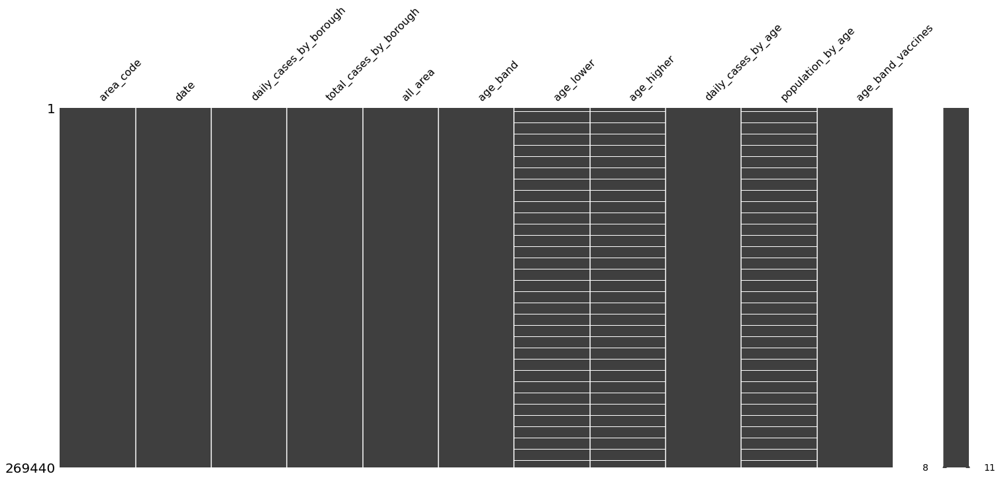

In [ ]:
import missingno as msno

msno.matrix(lon_cov_merge_1)

##### NaNs related to age_bands

In [ ]:
lon_cov_merge_1.isna().sum()

area_code                     0
date                          0
daily_cases_by_borough        0
total_cases_by_borough        0
all_area                      0
age_band                      0
age_lower                 13472
age_higher                13472
daily_cases_by_age            0
population_by_age         13472
age_band_vaccines             0
dtype: int64

In [ ]:
lon_cov_merge_1[lon_cov_merge_1['age_lower'].isna()].head(n=3)

,area_code,date,daily_cases_by_borough,total_cases_by_borough,all_area,age_band,age_lower,age_higher,daily_cases_by_age,population_by_age,age_band_vaccines
19,E09000002,2020-03-08,1,3,E12000007,unassigned,NaN,NaN,0,NaN,Under 50
39,E09000003,2020-03-08,1,8,E12000007,unassigned,NaN,NaN,0,NaN,Under 50
59,E09000004,2020-03-08,0,0,E12000007,unassigned,NaN,NaN,0,NaN,Under 50


In [ ]:
lon_cov_merge_1[lon_cov_merge_1['date']=='2020-03-08'].head(n=3)

,area_code,date,daily_cases_by_borough,total_cases_by_borough,all_area,age_band,age_lower,age_higher,daily_cases_by_age,population_by_age,age_band_vaccines
0,E09000002,2020-03-08,1,3,E12000007,0 - 4 years,0.0,4.0,0,606004.0,Under 45
1,E09000002,2020-03-08,1,3,E12000007,5 - 9 years,5.0,9.0,0,602992.0,Under 45
2,E09000002,2020-03-08,1,3,E12000007,10 - 14 years,10.0,14.0,0,537605.0,Under 45


In [ ]:
lon_cov_merge_1[lon_cov_merge_1['age_lower'].isna()].age_band.unique()

array(['unassigned'], dtype=object)

We determine that the NaNs regarding the first preprocessing correspond to **'unassigned'** age bands, thus it is considered to exclude such entries since they do not suport relevant information and the imputed information such as **daily_cases_by_borough** it is already constraint in 'assigned' age bands.

In [ ]:
lon_cov_merge_1 = lon_cov_merge_1[lon_cov_merge_1['age_lower'].notna()]

Thus having:

In [ ]:
lon_cov_merge_1.isna().sum()

area_code                 0
date                      0
daily_cases_by_borough    0
total_cases_by_borough    0
all_area                  0
age_band                  0
age_lower                 0
age_higher                0
daily_cases_by_age        0
population_by_age         0
age_band_vaccines         0
dtype: int64

#### Merge **Cases + Vaccinations**

In [ ]:
all_datasets['vacinations'].head(n=3)

,area_code,date,dose,age_band_vaccines,number_vaccines,percent_vaccine
0,E09000002,2021-02-22,1st dose,70-74,4059,0.839330
1,E09000003,2021-02-22,1st dose,70-74,12806,0.888688
2,E09000004,2021-02-22,1st dose,70-74,9800,0.956098


In [ ]:
lon_cov_merge_2 = reduce(lambda  left,right: pd.merge(left,right,on=['date','area_code','age_band_vaccines'],
                                            how="left"), [lon_cov_merge_1,all_datasets['vacinations']])

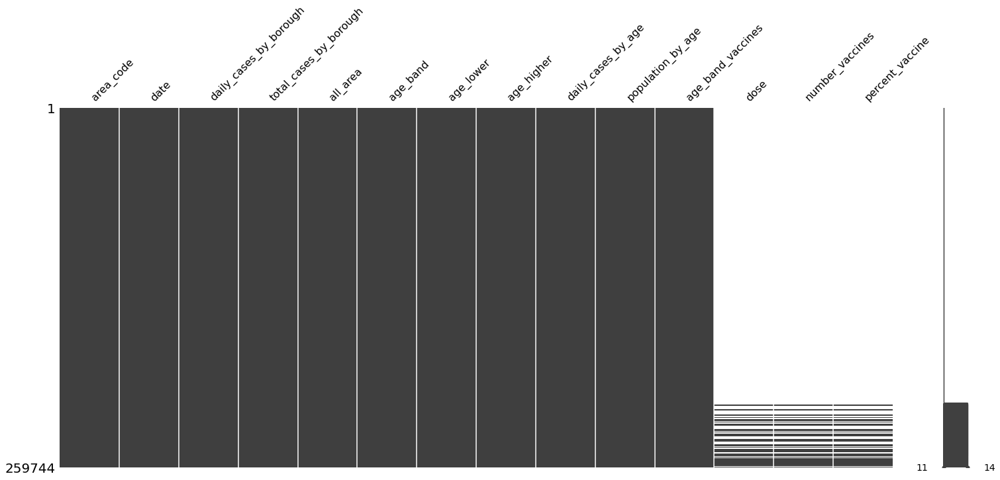

In [ ]:
msno.matrix(lon_cov_merge_2)

##### **NaNs** related to **vaccination period start** + **vaccination  age bands start** 

In [ ]:
lon_cov_merge_2[lon_cov_merge_2['date']=='2021-02-22'][lon_cov_merge_2['dose'].isna()].head(n=3)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



,area_code,date,daily_cases_by_borough,total_cases_by_borough,all_area,age_band,age_lower,age_higher,daily_cases_by_age,population_by_age,age_band_vaccines,dose,number_vaccines,percent_vaccine
213408,E09000002,2021-02-22,40,22798,E12000007,0 - 4 years,0.0,4.0,40,606004.0,Under 45,NaN,NaN,NaN
213409,E09000002,2021-02-22,40,22798,E12000007,5 - 9 years,5.0,9.0,28,602992.0,Under 45,NaN,NaN,NaN
213410,E09000002,2021-02-22,40,22798,E12000007,10 - 14 years,10.0,14.0,37,537605.0,Under 45,NaN,NaN,NaN


In this case we constatate how NaNs regarding the merge of **vaccinations + cases** are either related to:

*   **Pandemic start** when **no vaccination was yet developed**, corresponding to the large empty band at the begining.
*   **Younger Age bands** since the vaccination is provided first to older age bands.

Then, instead of removing such NaNs, in this case is considered to input as **0 vacination** in such casuistic.


In [ ]:
lon_cov_merge_2.fillna(0, inplace=True)

#### **Merge Activity: Activity measures** (retail, transit, remotework) + previous merge (**Cases + Vaccinations**)

To start we notice that the **remote/residentaial** percentage at the begining of the pandemic has no data entry, since such **feature** was not yet **measured**, then we check the start of such measurement:

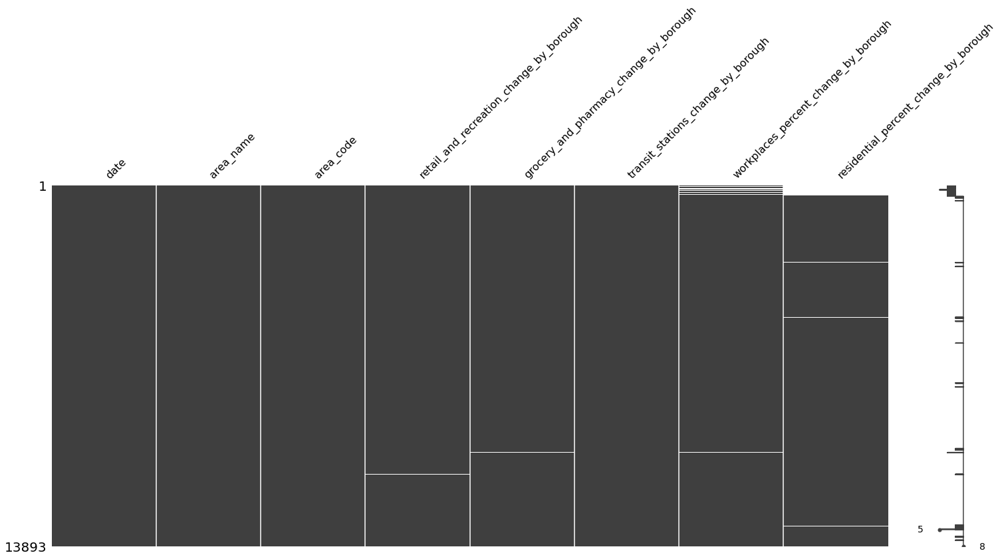

In [ ]:
msno.matrix(all_datasets['activity_by_borough'])

In [ ]:
residential_percent = all_datasets['activity_by_borough'][all_datasets['activity_by_borough'].residential_percent_change_by_borough.isna()]
residential_percent.head(n=2)

,date,area_name,area_code,retail_and_recreation_change_by_borough,grocery_and_pharmacy_change_by_borough,transit_stations_change_by_borough,workplaces_percent_change_by_borough,residential_percent_change_by_borough
22,2020-03-08,City of London,E09000001,2.0,-4.0,-17,NaN,NaN
23,2020-03-09,City of London,E09000001,-10.0,-5.0,-8,-6.0,NaN


We decide to merge and then exclude the NaN entries, since there are few and related to some few Neighbours.

In [ ]:
residential_percent.isna().sum()

date                                         0
area_name                                    0
area_code                                    0
retail_and_recreation_change_by_borough      0
grocery_and_pharmacy_change_by_borough       9
transit_stations_change_by_borough           0
workplaces_percent_change_by_borough       144
residential_percent_change_by_borough      526
dtype: int64

In [ ]:
lon_cov_merge_3 = reduce(lambda  left,right: pd.merge(left,right,on=['date', 'area_code'],
                                            how='outer'), [lon_cov_merge_2,all_datasets['activity_by_borough']])

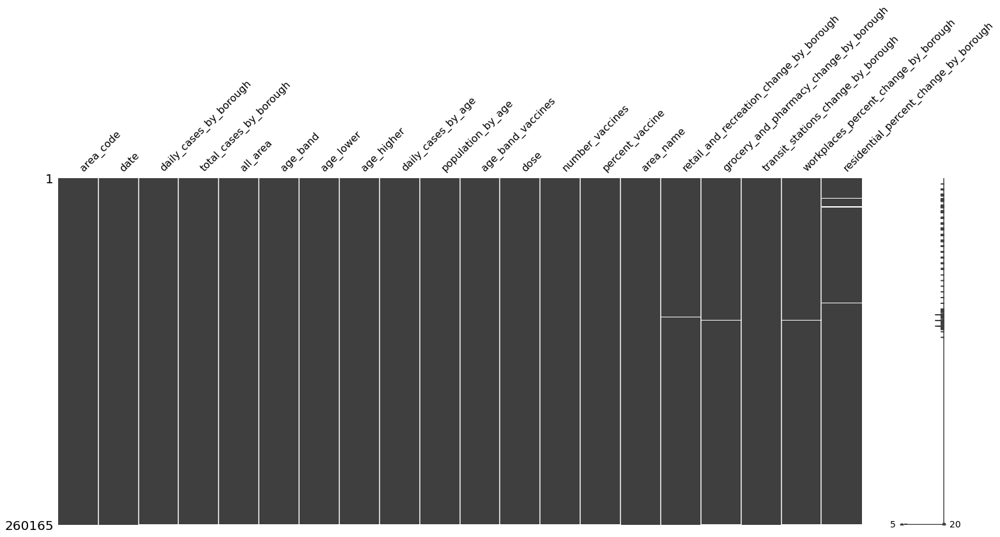

In [ ]:
msno.matrix(lon_cov_merge_3)

In [ ]:
for col in lon_cov_merge_3:
    lon_cov_merge_3 = lon_cov_merge_3[lon_cov_merge_3[col].notna()]
lon_cov_merge_3.isna().sum()

area_code                                  0
date                                       0
daily_cases_by_borough                     0
total_cases_by_borough                     0
all_area                                   0
age_band                                   0
age_lower                                  0
age_higher                                 0
daily_cases_by_age                         0
population_by_age                          0
age_band_vaccines                          0
dose                                       0
number_vaccines                            0
percent_vaccine                            0
area_name                                  0
retail_and_recreation_change_by_borough    0
grocery_and_pharmacy_change_by_borough     0
transit_stations_change_by_borough         0
workplaces_percent_change_by_borough       0
residential_percent_change_by_borough      0
dtype: int64

In [ ]:
lon_cov_merge_3 = reduce(lambda  left,right: pd.merge(left,right,on=['date', 'all_area'],
                                            how='outer'), [lon_cov_merge_3,all_datasets['activity_transport'],all_datasets['activity_retail']])

In [ ]:
lon_cov_merge_3=lon_cov_merge_3.drop('all_area',axis=1)

#### Further pretreatment on Activity Records

Once at this point we have activity imputed and merged for the **whole city** and in some entries **by borough**. Since we want to build a predictive model based too on **boroughs**, the relative diference (labeled as **_diff**) from the reference column (**retail_and_recreation_change_by_borough** and **retail_and_recreation_change_by_borough**) is used in order to have also activity **by_borough** for all activity kinds.

In [ ]:
[n for n in lon_cov_merge_3.columns if 'diff' in n]

['transport_stations_diff',
 'transit_stations_diff',
 'journeys_stations_diff',
 'retail_social_diff',
 'retail_restaurants_diff']

In [ ]:
lon_cov_merge_3['retail_social_diff'] += lon_cov_merge_3['retail_and_recreation_change_by_borough']
lon_cov_merge_3['retail_restaurants_diff'] += lon_cov_merge_3['retail_and_recreation_change_by_borough']

lon_cov_merge_3['transit_stations_diff'] += lon_cov_merge_3['transit_stations_change_by_borough']
lon_cov_merge_3['transport_stations_diff'] += lon_cov_merge_3['transit_stations_change_by_borough']
lon_cov_merge_3['journeys_stations_diff'] += lon_cov_merge_3['transit_stations_change_by_borough']

Now in such columns we have the infered by borough, based on the change relative to the reference column by_borough forom the whole city correspondent activity, and we rename them accordingly. All that are **not labeled** by **_by_borough** are for the whole city.

In [ ]:
lon_cov_merge_3 = lon_cov_merge_3.rename(columns={"retail_social_diff": "social_change_by_borough", 
                                                  "retail_restaurants_diff":"restaurant_change_by_borough",
                                                  "transit_stations_diff":"transit_by_borough",
                                                  "transport_stations_diff":"transport_by_borough",
                                                  "journeys_stations_diff":"journeys_by_borough"})

#### **Merge housing: Activity measures** (retail, transit, remotework) + previous merge (**Cases + Vaccinations**)

In [ ]:
all_datasets['housing_yearly'].head(n=1)

,date,area_code,area,median_salary_borough,mean_salary_borough
1020,2019-12-01,E09000001,city of london,61636.0,88342


For merging housing information we only need to link the information regarding **mean_salary** and **median_salary**, since area name was already stated by activity and this case is **housing yearly**.

In [ ]:
all_datasets['housing_yearly'] = all_datasets['housing_yearly'].drop(['date','area'],axis=1)

##### **NaNs** related to some missing values in **housing** by neighbourhood.


We identify 3 neighbourhoodswith NaN **median**, which we will infer with a value of a neighbourhood that shares a close **mean salary**. Also a **mean** inputed **'#'**.

In [ ]:
all_datasets['housing_yearly'].isna().sum()

area_code                0
median_salary_borough    3
mean_salary_borough      0
dtype: int64

In [ ]:
all_datasets['housing_yearly'].at[1025, 'median_salary_borough'] = 32321.0
all_datasets['housing_yearly'].at[1062, 'median_salary_borough'] = 41076.0
all_datasets['housing_yearly'].at[1063, 'median_salary_borough'] = 30667.0
all_datasets['housing_yearly'].at[1043, 'mean_salary_borough'] = 33978

In [ ]:
all_datasets['housing_yearly'].isna().sum()

area_code                0
median_salary_borough    0
mean_salary_borough      0
dtype: int64

In [ ]:
lon_cov_merge_4 = reduce(lambda  left,right: pd.merge(left,right,on=['area_code'],
                                            how='outer'), [lon_cov_merge_3,all_datasets['housing_yearly']])

In [ ]:
for col in lon_cov_merge_4:
    lon_cov_merge_4 = lon_cov_merge_4[lon_cov_merge_4[col].notna()]

## Final Merge: Our preprocessed COVID-19 Dataset

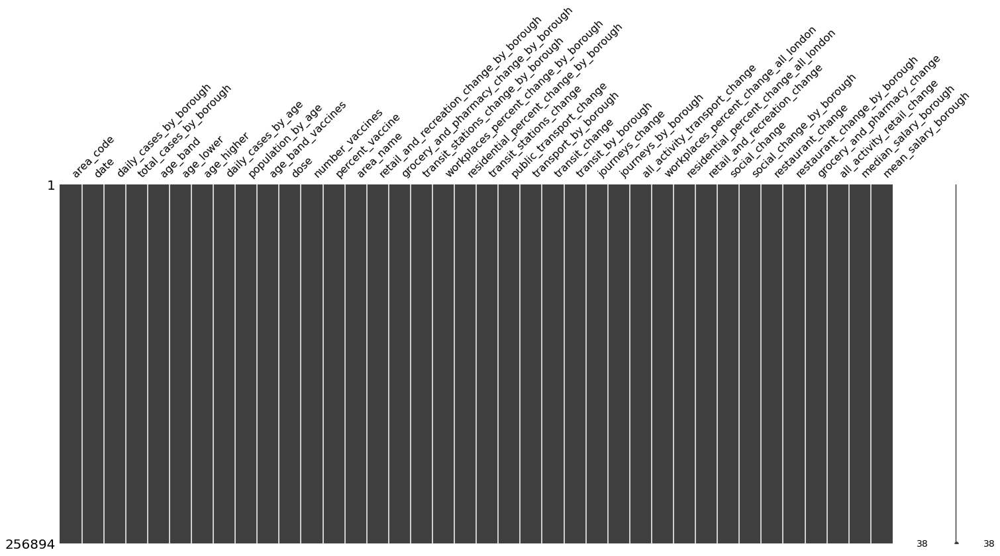

In [ ]:
msno.matrix(lon_cov_merge_4)

In [ ]:
lon_cov_merge_4

,area_code,date,daily_cases_by_borough,total_cases_by_borough,age_band,age_lower,age_higher,daily_cases_by_age,population_by_age,age_band_vaccines,dose,number_vaccines,percent_vaccine,area_name,retail_and_recreation_change_by_borough,grocery_and_pharmacy_change_by_borough,transit_stations_change_by_borough,workplaces_percent_change_by_borough,residential_percent_change_by_borough,transit_stations_change,public_transport_change,transport_by_borough,transit_change,transit_by_borough,journeys_change,journeys_by_borough,all_activity_transport_change,workplaces_percent_change_all_london,residential_percent_change_all_london,retail_and_recreation_change,social_change,social_change_by_borough,restaurant_change,restaurant_change_by_borough,grocery_and_pharmacy_change,all_activity_retail_change,median_salary_borough,mean_salary_borough
0,E09000002,2020-03-08,1.0,3.0,0 - 4 years,0.0,4.0,0.0,606004.0,Under 45,0,0.0,0.000000,Barking and Dagenham,2.0,9.0,3.0,0.0,0.0,-4.000000,-0.276299,-0.723701,0.860000,-1.860000,-6.000000,5.000000,-2.354075,-2.46875,2.18750,-1.000000,-6.380133,7.380133,-7.000000,8.000000,3.000000,-2.845033,28738.0,32010
1,E09000002,2020-03-08,1.0,3.0,5 - 9 years,5.0,9.0,0.0,602992.0,Under 45,0,0.0,0.000000,Barking and Dagenham,2.0,9.0,3.0,0.0,0.0,-4.000000,-0.276299,-0.723701,0.860000,-1.860000,-6.000000,5.000000,-2.354075,-2.46875,2.18750,-1.000000,-6.380133,7.380133,-7.000000,8.000000,3.000000,-2.845033,28738.0,32010
2,E09000002,2020-03-08,1.0,3.0,10 - 14 years,10.0,14.0,0.0,537605.0,Under 45,0,0.0,0.000000,Barking and Dagenham,2.0,9.0,3.0,0.0,0.0,-4.000000,-0.276299,-0.723701,0.860000,-1.860000,-6.000000,5.000000,-2.354075,-2.46875,2.18750,-1.000000,-6.380133,7.380133,-7.000000,8.000000,3.000000,-2.845033,28738.0,32010
3,E09000002,2020-03-08,1.0,3.0,15 - 19 years,15.0,19.0,0.0,467602.0,Under 50,0,0.0,0.000000,Barking and Dagenham,2.0,9.0,3.0,0.0,0.0,-4.000000,-0.276299,-0.723701,0.860000,-1.860000,-6.000000,5.000000,-2.354075,-2.46875,2.18750,-1.000000,-6.380133,7.380133,-7.000000,8.000000,3.000000,-2.845033,28738.0,32010
4,E09000002,2020-03-08,1.0,3.0,20 - 24 years,20.0,24.0,2.0,565427.0,Under 55,0,0.0,0.000000,Barking and Dagenham,2.0,9.0,3.0,0.0,0.0,-4.000000,-0.276299,-0.723701,0.860000,-1.860000,-6.000000,5.000000,-2.354075,-2.46875,2.18750,-1.000000,-6.380133,7.380133,-7.000000,8.000000,3.000000,-2.845033,28738.0,32010
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
256889,E09000033,2021-05-02,8.0,14277.0,80 - 84 years,80.0,84.0,2.0,150816.0,80+,2nd dose,4939.0,0.548534,Westminster,-64.0,-25.0,-58.0,-32.0,5.0,-37.939394,-27.888542,-47.949148,-46.748761,-66.809367,-28.601183,-48.661789,-35.294470,-20.56250,3.96875,-38.545455,-15.978056,-41.432601,-18.200984,-43.655529,-9.030303,-20.438699,43556.0,60010
256890,E09000033,2021-05-02,8.0,14277.0,85 - 89 years,85.0,89.0,1.0,93461.0,80+,1st dose,5658.0,0.628387,Westminster,-64.0,-25.0,-58.0,-32.0,5.0,-37.939394,-27.888542,-47.949148,-46.748761,-66.809367,-28.601183,-48.661789,-35.294470,-20.56250,3.96875,-38.545455,-15.978056,-41.432601,-18.200984,-43.655529,-9.030303,-20.438699,43556.0,60010
256891,E09000033,2021-05-02,8.0,14277.0,85 - 89 years,85.0,89.0,1.0,93461.0,80+,2nd dose,4939.0,0.548534,Westminster,-64.0,-25.0,-58.0,-32.0,5.0,-37.939394,-27.888542,-47.949148,-46.748761,-66.809367,-28.601183,-48.661789,-35.294470,-20.56250,3.96875,-38.545455,-15.978056,-41.432601,-18.200984,-43.655529,-9.030303,-20.438699,43556.0,60010
256892,E09000033,2021-05-02,8.0,14277.0,90+ years,90.0,90.0,0.0,57456.0,80+,1st dose,5658.0,0.628387,Westminster,-64.0,-25.0,-58.0,-32.0,5.0,-37.939394,-27.888542,-47.949148,-46.748761,-66.809367,-28.601183,-48.661789,-35.294470,-20.56250,3.96875,-38.545455,-15.978056,-41.432601,-18.200984,-43.655529,-9.030303,-20.438699,43556.0,60010


### Export .csv

We export the final merge for portability issues.

In [ ]:
lon_cov_merge_4.to_csv('./SDAV_COVID_London_Merge.csv')

##2.2 Dataset descriptive statistics: key points/plots from exploratory data analysis

### Descriptive insight on the data merge

In [208]:
lon_cov_merge_4.describe()

,daily_cases_by_borough,total_cases_by_borough,age_lower,age_higher,daily_cases_by_age,population_by_age,number_vaccines,percent_vaccine,retail_and_recreation_change_by_borough,grocery_and_pharmacy_change_by_borough,transit_stations_change_by_borough,workplaces_percent_change_by_borough,residential_percent_change_by_borough,transit_stations_change,public_transport_change,transport_by_borough,transit_change,transit_by_borough,journeys_change,journeys_by_borough,all_activity_transport_change,workplaces_percent_change_all_london,residential_percent_change_all_london,retail_and_recreation_change,social_change,social_change_by_borough,restaurant_change,restaurant_change_by_borough,grocery_and_pharmacy_change,all_activity_retail_change,median_salary_borough
count,256894.000000,256894.000000,256894.000000,256894.000000,256894.000000,256894.000000,256894.000000,256894.000000,256894.000000,256894.000000,256894.000000,256894.000000,256894.000000,256894.000000,256894.000000,256894.000000,256894.000000,256894.000000,256894.000000,256894.000000,256894.000000,256894.000000,256894.000000,256894.000000,256894.000000,256894.000000,256894.000000,256894.000000,256894.000000,256894.000000,256894.000000
mean,53.347229,7890.431088,45.120205,48.908289,89.489221,470463.643067,1116.714746,0.069912,-49.162238,-15.228335,-54.711414,-49.310424,18.217806,-58.299883,-65.701952,-44.697706,-52.422890,-63.586337,-65.499489,-45.394758,-60.481053,-47.336650,17.319135,-54.789391,-61.921565,-25.984260,-66.219613,-28.370649,-17.757397,-50.171992,34277.773490
std,105.461224,9653.585266,27.417682,27.083398,209.495257,228764.154731,4337.658083,0.226586,22.003968,15.085902,15.451307,19.208054,8.484793,12.646932,19.140362,14.578630,21.710959,15.175927,18.136553,14.246422,16.693270,20.776204,8.867197,17.047440,27.335824,23.508568,32.117823,22.277161,11.689318,19.101397,4166.255488
min,0.000000,0.000000,0.000000,4.000000,0.000000,57456.000000,0.000000,0.000000,-96.000000,-93.000000,-97.000000,-91.000000,0.000000,-92.000000,-99.998238,-89.001762,-88.790000,-110.390000,-94.000000,-95.000000,-92.614560,-87.939394,-0.875000,-92.000000,-97.055914,-84.517733,-100.000000,-122.430000,-84.000000,-86.370567,28258.000000
25%,4.000000,979.000000,20.000000,24.000000,4.000000,273546.000000,0.000000,0.000000,-66.000000,-23.000000,-66.000000,-63.000000,13.000000,-68.000000,-77.029630,-55.657953,-66.750000,-73.370000,-80.000000,-56.000000,-72.991118,-61.787879,12.187500,-69.000000,-93.516301,-43.432601,-99.870000,-44.010000,-24.000000,-67.681910,31642.000000
50%,13.000000,2014.000000,45.000000,49.000000,19.000000,537605.000000,0.000000,0.000000,-50.000000,-14.000000,-55.000000,-53.000000,18.000000,-58.000000,-66.368013,-43.949148,-56.630000,-64.690000,-70.000000,-45.000000,-61.296895,-51.969697,16.812500,-56.757576,-60.152070,-26.016810,-62.430000,-29.100000,-17.212121,-47.522033,32947.000000
75%,48.000000,13925.000000,70.000000,74.000000,66.000000,606004.000000,0.000000,0.000000,-31.000000,-7.000000,-44.000000,-37.000000,24.000000,-50.000000,-52.260572,-34.923650,-32.700000,-55.809367,-50.000000,-36.000000,-47.239391,-35.562500,24.281250,-40.000000,-39.947753,-7.983420,-38.049469,-12.655529,-12.484848,-36.669878,35237.000000
max,1041.000000,35658.000000,90.000000,90.000000,2296.000000,838109.000000,60265.000000,1.050919,22.000000,54.000000,17.000000,4.000000,42.000000,-4.000000,-0.276299,13.276299,0.860000,12.140000,-3.000000,19.000000,-2.354075,1.906250,37.612903,-1.000000,-2.493208,48.632830,54.430000,70.000000,30.000000,-2.845033,46142.000000


We hereby realize that there is variance between some entries, which will present problems when we deal with measures that difer, thus requiring normalization, as will be later exposed.

### Cases data exploration

To get an initial idea of how COVID-19 cases impacted London, we plotted two boxplots: Daily new cases per area and Daily new cases per age group. The goal was to get a general understanding of the distribution of the cases throughout the city.

Text(0, 0.5, 'Area')

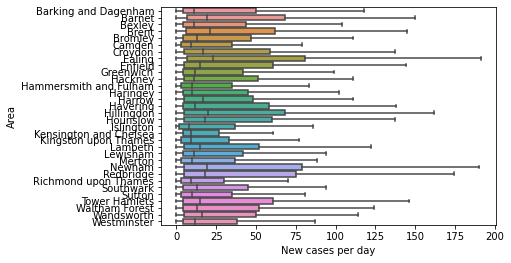

In [ ]:
sns.boxplot(y=lon_cov_merge_4["area_name"], x=lon_cov_merge_4["daily_cases_by_borough"], showfliers=False )
plt.xlabel('New cases per day')
plt.ylabel('Area')

From the plot above, it can be seen that the new daily cases in the city center have been lower during the whole pandemic. For instance, areas like Kensington and Chelsea, Kingston upon Thames and Westminster, we see that he maximum number of cases is marginally lower compared to other areas. We see that the median is also relatively low, which means that most days have had lower new cases. One of the reasons for this, could be that the density of people living in the city center is lower since housing is more expensive. In section 5, a map with the percentage of total cases per capita is plotted to investigate this hypothesis further. 

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



Text(0, 0.5, 'Age range')

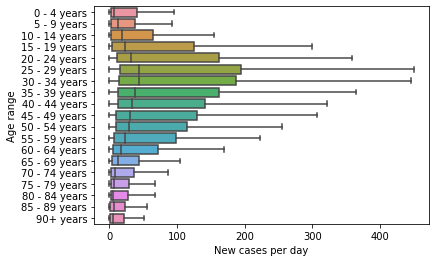

In [ ]:
sns.boxplot(lon_cov_merge_4["daily_cases_by_age"], y=lon_cov_merge_4["age_band"], showfliers=False )
plt.xlabel('New cases per day')
plt.ylabel('Age range')

This plot follows a normal distribution centered with the peak on younger generations, who can be assumed to have a more social and outgoing lifestyle. It is not possible to derive a single explanatory factor for the reason of the normal distribution. A number of factors may be taken into consideration when looking specifically on age groups 24 to 34 years old. Primarily, the NHS communication has been focused on protecting the elders as these are proven to be more vulnerable to COVID-19. This may have led to a sort of apathy in the younger generations. Secondly, 24- to 34-year olds are less likely to have kids and established lives. They will likely live in a shared apartment with other young people and more frequently meet new people. When comparing them to younger age groups an explanatory factor can be that the younger often live at home and still attend school which has been closed down. This has limited their social interaction.



### Vaccinations data exploration

In [ ]:

data = pd.read_csv("nhse_weekly_vaccines_london_ltla.csv",index_col = 0,low_memory=False) 
data["itla"] = data.index
df=data[data["end_date"]=="2021-04-04"][["age_band","percent_vaccine","itla"]]

Total numbers of vaccinated in London

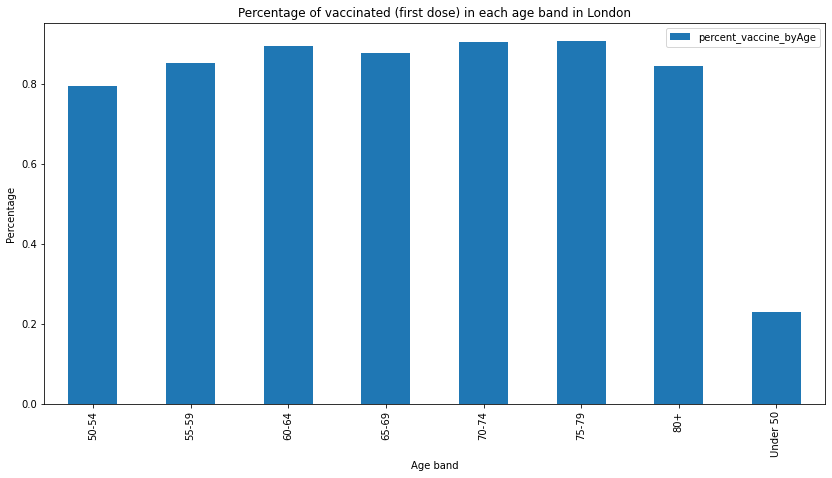

In [ ]:
vacPop=data[data["end_date"]=="2021-04-04"].groupby("age_band").sum()[["vaccines","population"]]
vacPop=vacPop.reset_index("age_band")
vacPop["percent_vaccine_byAge"]=vacPop["vaccines"]/vacPop["population"]

vacPop.plot(x="age_band",y="percent_vaccine_byAge",kind="bar",figsize=(14,7))
plt.xlabel("Age band")
plt.ylabel("Percentage ")
plt.title("Percentage of vaccinated (first dose) in each age band in London")
plt.show()

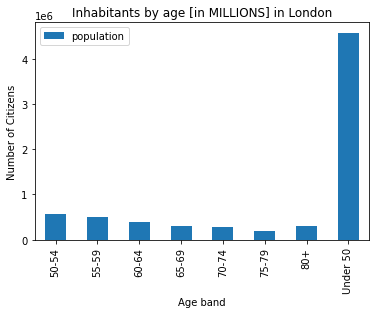

In [ ]:
vacPop.plot(x="age_band",y="population",kind="bar")
plt.xlabel("Age band")
plt.ylabel("Number of Citizens")
plt.title("Inhabitants by age [in MILLIONS] in London")
plt.show()

Distirbutions of vaccines (first dose) in age groups in London


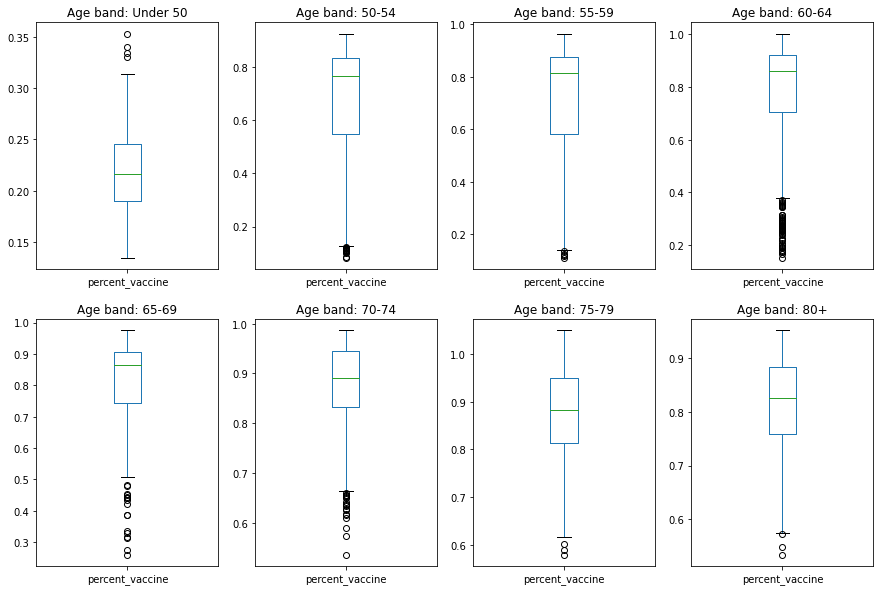

In [ ]:
age_bands=[ 'Under 50','50-54', '55-59','60-64', '65-69','70-74', '75-79', '80+']
fig, axs = plt.subplots(2, 4,figsize=(15,10))
idx=0
print("Distirbutions of vaccines (first dose) in age groups in London")
for i in range (2):
    for j in range (4):
        bp=data[data["age_band"]==age_bands[idx]][["percent_vaccine","age_band"]]
        axs[i,j].set_title("Age band: "+str(age_bands[idx]))
        bp.plot(x="age_band",y="percent_vaccine",kind="box",ax=axs[i,j])
        
        idx+=1
    

### Activity data exploration

In [219]:
activity_retail_ = all_datasets['activity_retail'].head(n=3).drop(['retail_social_diff','all_area','retail_restaurants_diff','date'],axis = 1)

In [214]:
activity_retail_

,retail_and_recreation_change,social_change,restaurant_change,date,grocery_and_pharmacy_change,all_activity_retail_change,all_area
10,-1.0,-6.380133,-7.0,2020-03-08,3.0,-2.845033,E12000007
11,-3.0,-21.854685,-22.0,2020-03-09,6.0,-10.213671,E12000007
12,-6.0,-12.029882,-23.0,2020-03-10,7.0,-8.507470,E12000007


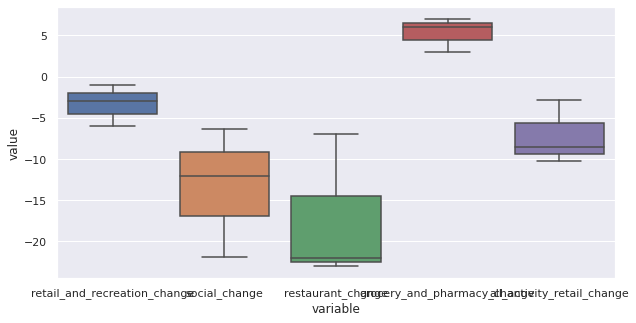

In [221]:
sns.boxplot(x="variable", y="value", data=pd.melt(activity_retail_))

From this first view we can tell how **restaurant_changes** show the lowest value meanwhile pharmacy the highest value. As later will be further detailed, this is due to pandemic trends. 


In [222]:
all_datasets['activity_transport']

,transit_stations_change,public_transport_change,transport_stations_diff,transit_change,transit_stations_diff,journeys_change,journeys_stations_diff,date,all_activity_transport_change,all_area,workplaces_percent_change_all_london,residential_percent_change_all_london
0,-4.000000,-0.276299,-3.723701,0.860000,-4.860000,-6.000000,2.000000,2020-03-08,-2.354075,E12000007,-2.468750,2.187500
1,-6.000000,-4.203300,-1.796700,-1.950000,-4.050000,-3.000000,-3.000000,2020-03-09,-3.788325,E12000007,-3.937500,1.580645
2,-7.000000,-7.378052,0.378052,-0.530000,-6.470000,-3.000000,-4.000000,2020-03-10,-4.477013,E12000007,-12.606061,2.281250
3,-10.000000,-9.203140,-0.796860,-5.670000,-4.330000,-9.000000,-1.000000,2020-03-11,-8.468285,E12000007,-12.212121,2.500000
4,-13.000000,-12.290990,-0.709010,-13.720000,0.720000,-16.000000,3.000000,2020-03-12,-13.752747,E12000007,-12.424242,2.687500
...,...,...,...,...,...,...,...,...,...,...,...,...
438,-48.454545,-38.403693,10.050852,-57.263912,-8.809367,-39.116335,9.338211,2021-04-28,-45.809621,E12000007,-46.878788,16.312500
439,-46.909091,-36.858238,10.050852,-55.718458,-8.809367,-37.570880,9.338211,2021-04-29,-44.264167,E12000007,-46.303030,15.062500
440,-42.181818,-32.130966,10.050852,-50.991185,-8.809367,-32.843608,9.338211,2021-04-30,-39.536894,E12000007,-44.212121,13.375000
441,-38.484848,-28.433996,10.050852,-47.294215,-8.809367,-29.146638,9.338211,2021-05-01,-35.839924,E12000007,-21.125000,5.656250


In [224]:
activity_transport_ = all_datasets['activity_transport'].head(n=3).drop(['journeys_stations_diff','transport_stations_diff','transit_stations_diff','all_area','date'],axis = 1)

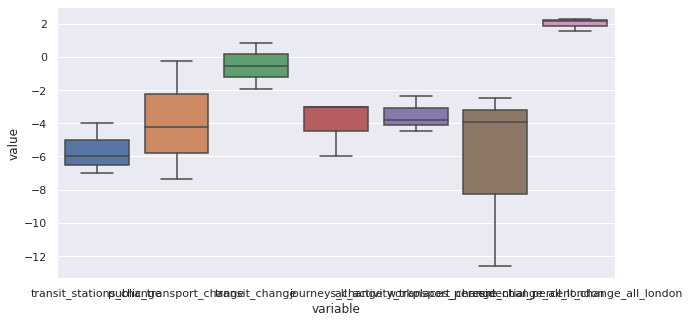

In [225]:
sns.boxplot(x="variable", y="value", data=pd.melt(activity_transport_))

From this first view we can tell how **remote_work** showed a high trend. Meanwhile transit stations afluency are reduced.

Mention though, that this trends are better justified and understood through longitudinal plots, where previous pandemic and postpandemic behaviours can be compared.

In [233]:
merged_activity = reduce(lambda  left,right: pd.merge(all_datasets['activity_transport'],
                                       all_datasets['activity_retail'],
                                       on=['date'],
                                            how='outer'), dataframes_activity
          ).drop(['journeys_stations_diff','retail_social_diff','retail_restaurants_diff','transport_stations_diff','transit_stations_diff','date'],axis = 1)

Finaly the correlations between the activites are explored through a **correlation matrix**.

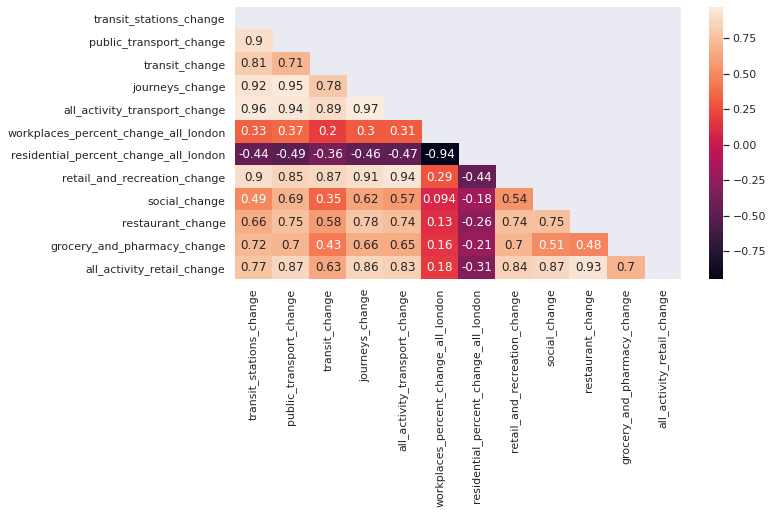

In [234]:
import seaborn as sn
corrMatrix = merged_activity.corr()

# Getting the Upper Triangle of the co-relation matrix
matrix = np.triu(corrMatrix)

sn.heatmap(corrMatrix, annot=True, mask=matrix)
plt.show()

There we can detail:
*   High inverse correlation between remote work and presential work, which has sense since they are the oposite.
*   Positive correlations between retail activity and straport, which is deduced by displacements imply more economical activity.



# 3. Data Analysis



## 3.1. Describe your data analysis and explain what you've learned about the dataset
From the data analysis done for this project we can highlight the following conclusions:

There was a higher number of people working from home during the first lockdown than the second and third. This could be due to a higher uncertainty at the beginning of the pandemic. Governments and businesses did not know the severity of the virus and how to act, so stronger restrictions were inforced and everyone was asked to work from home. However, during the second and third lockdown, other methods were applied, like getting tested before going to the office or seat booking allowing only a percentage of the office capacity.
\
As for restaurant bookings and social activity, it seems like they follow the same trends. It is interesting to see how restaurant bookings almost reached precovid levels after the first lockdown and the conficence maintained after the second lockdown. However, the third lockdown seems to have affected restaurant bookings negatively as, despite being very progressed in vaccinations, bookings are only 50% precovid level. Exactly the same applies to social activities.
\
Also, here seems to be a reversed proportionallity between working from home and how many people do groceries. The dataset does not reveal any conclusions to the motivation but somewhow we can see that the more people work from home, the less they go to the groceries. It is not possible to conclude the reason, but suggestions could be that, since a person working from home is not required to go out to commute everyday, they would do groceries less frequently and have fewer impulse purchases.
\
Furthermore, lockdown really decreased the cases. There have been some discussions on the effect of restricting mobility and not allowing leaving home, but from the plots we can see how those measures were highly effective in reducing number of cases.
\
Lastly, roceries and pharmacies were more impacted in the first lockdown but were more stable throughout the second and third wave. Retail is volatile to restrictions most likely due to gathering bans and mobility restrictions and has not been able to recover to a pre-COVID19 level through online sales.


## 3.2. Machine learning: 
**LinReg**/**RandomForest** (Neighbourhod, Activity Retail Type, Activity Transport, Mobility Reports, COV Cases, Vacinations) -> **ActivityRetailValue**

We propose a **predictive model** in order to predict **ActivityRetailValue** (i.e. the performance of “Grocery and pharmacy”, “Social”, “Restaurant” and “Restaurant and recreation”) according to a COVID level, among other indicators. Point out here that eventhough the model is fited with more features, for the web output we only variate **Neighbourhod** and **COV Cases**, in order to simplify combinations and the web form. Then all the predictions are precomputed hereby and then the web form shows the diferent outcomes.


The COVID level is given by the number of daily cases and vaccines administered. The lower the daily cases and the higher the vaccines doses are, the lower the COVID level will be. In the dropdown list, a neighbourhood can be selected and the performance for each business will be calculated for that specific neighbourhood. It is interesting to note that, no matter the neighbourhood or COVID level, the performance of groceries and pharmacy remains almost in 100 for all neighbourhoods. Contrary to this, retail and recreation seems to be the kind of business with most difficulties to recover, since even with the lowest COVID level, remains only around 80 for all neighbourhoods. On the other hand, social and restaurants are the ones that varies the most depending on COVID level. These variations are mainly due to restrictions. The higher the COVID cases are, the stricter the restrictions get. Restrictions affect differently to each kind of businesses. Groceries and pharmacies are not affected by restrictions they can remain open even during the lockdowns. As for retail, it is affected by restrictions but there is still the option for online shopping, so it makes sense that the performance does not change that much according to COVID level. Lastly, restaurants and social are the most affected by restrictions and, therefore by COVID level, since the need to be closed down when high COVID levels.

The steps followed for the Machine Learning process have been: Method selection, parameter tunning and performance assesment (with RMSE, since it is a regression). 
Since the prediction target is a **continuous value, regression approaches** are assessed and then selected.


### 3.2.1. Pretreatment

Hereby we restructure (again) the Datset in order to fit it into our model.
The extra dimensions that the activity column stratification implied can be collapsed to 2 columns for each kind of activity (one indicating the kind of activity and another the change/value). 

This is considered in order to simplify the curse of dimensionality on the model and having only one output target.

In [ ]:
#daily_cases_by_borough
#area_code
#workplaces_percent_change_by_borough
#transit_stations_change_by_borough
#number_vaccines

In [ ]:
retail_and_recreation_change_by_borough = pd.DataFrame(data={'activity_retail_value':lon_cov_merge_4['retail_and_recreation_change_by_borough'],
                                              'date':lon_cov_merge_4.date,
                                              'area_code':lon_cov_merge_4.area_code,
                                              'category_retail':np.full(len(lon_cov_merge_4), 'retail_and_recreation_change_by_borough')
                                              },
                                        )
grocery_and_pharmacy_change_by_borough = pd.DataFrame(data={'activity_retail_value':lon_cov_merge_4['grocery_and_pharmacy_change_by_borough'],
                                              'date':lon_cov_merge_4.date,
                                              'area_code':lon_cov_merge_4.area_code,
                                              'category_retail':np.full(len(lon_cov_merge_4), 'grocery_and_pharmacy_change_by_borough')
                                              },
                                        )
social_change_by_borough = pd.DataFrame(data={'activity_retail_value':lon_cov_merge_4['social_change_by_borough'],
                                              'date':lon_cov_merge_4.date,
                                              'area_code':lon_cov_merge_4.area_code,
                                              'category_retail':np.full(len(lon_cov_merge_4), 'social_change_by_borough')
                                              },
                                        )
restaurant_change_by_borough = pd.DataFrame(data={'activity_retail_value':lon_cov_merge_4['restaurant_change_by_borough'],
                                              'date':lon_cov_merge_4.date,
                                              'area_code':lon_cov_merge_4.area_code,
                                              'category_retail':np.full(len(lon_cov_merge_4), 'restaurant_change_by_borough')
                                              },
                                        )

dataframes_activity = [
retail_and_recreation_change_by_borough,
grocery_and_pharmacy_change_by_borough,
social_change_by_borough,
restaurant_change_by_borough
]

In [ ]:
lon_cov_merge_reg = reduce(lambda  left,right: pd.merge(left,right,on=['date','category_retail','area_code','activity_retail_value'],
                                            how='outer'), dataframes_activity)

lon_cov_merge_reg.head(n=2)

,activity_retail_value,date,area_code,category_retail
0,2.0,2020-03-08,E09000002,retail_and_recreation_change_by_borough
1,2.0,2020-03-08,E09000002,retail_and_recreation_change_by_borough


In [ ]:
lon_cov_sub_merge =  pd.DataFrame(lon_cov_merge_4, columns=['date', 'area_code','daily_cases_by_borough', 'number_vaccines', 'workplaces_percent_change_by_borough', 'transit_stations_change_by_borough'])
lon_cov_sub_merge.head(n=2)

,date,area_code,daily_cases_by_borough,number_vaccines,workplaces_percent_change_by_borough,transit_stations_change_by_borough
0,2020-03-08,E09000002,1.0,0.0,0.0,3.0
1,2020-03-08,E09000002,1.0,0.0,0.0,3.0


In [ ]:
lon_cov_merge_reg = pd.merge(lon_cov_sub_merge,lon_cov_merge_reg, on=['date','area_code'],
                        how='inner').drop_duplicates().reset_index(drop=True)
lon_cov_merge_reg.head(n=2)

,date,area_code,daily_cases_by_borough,number_vaccines,workplaces_percent_change_by_borough,transit_stations_change_by_borough,activity_retail_value,category_retail
0,2020-03-08,E09000002,1.0,0.0,0.0,3.0,2.0,retail_and_recreation_change_by_borough
1,2020-03-08,E09000002,1.0,0.0,0.0,3.0,9.0,grocery_and_pharmacy_change_by_borough


Codify as categorical value **area_code** and **category_retail**.

In [ ]:
area_code_mapping = {n:idx for idx, n in enumerate(lon_cov_merge_reg.area_code.unique())}
retail_code_mapping = {n:idx for idx, n in enumerate(lon_cov_merge_reg.category_retail.unique())}

lon_cov_merge_reg['area_code'] = lon_cov_merge_reg['area_code'].map(area_code_mapping)
lon_cov_merge_reg['category_retail'] = lon_cov_merge_reg['category_retail'].map(retail_code_mapping)

Now the merged dataset is already codified for the Linear model, where the **target column** (y) is **activity_retail_value**. 

We drop the data as it was just needed to pivot all relevant features and we convert activity_retail_value **from change to value with the baseline**.

In [ ]:
lon_cov_merge_reg = lon_cov_merge_reg.drop('date', axis=1)
lon_cov_merge_reg['activity_retail_value'] = lon_cov_merge_reg['activity_retail_value'] + baseline
lon_cov_merge_reg.head(n=3)

,area_code,daily_cases_by_borough,number_vaccines,workplaces_percent_change_by_borough,transit_stations_change_by_borough,activity_retail_value,category_retail
0,0,1.0,0.0,0.0,3.0,102.000000,0
1,0,1.0,0.0,0.0,3.0,109.000000,1
2,0,1.0,0.0,0.0,3.0,107.380133,2


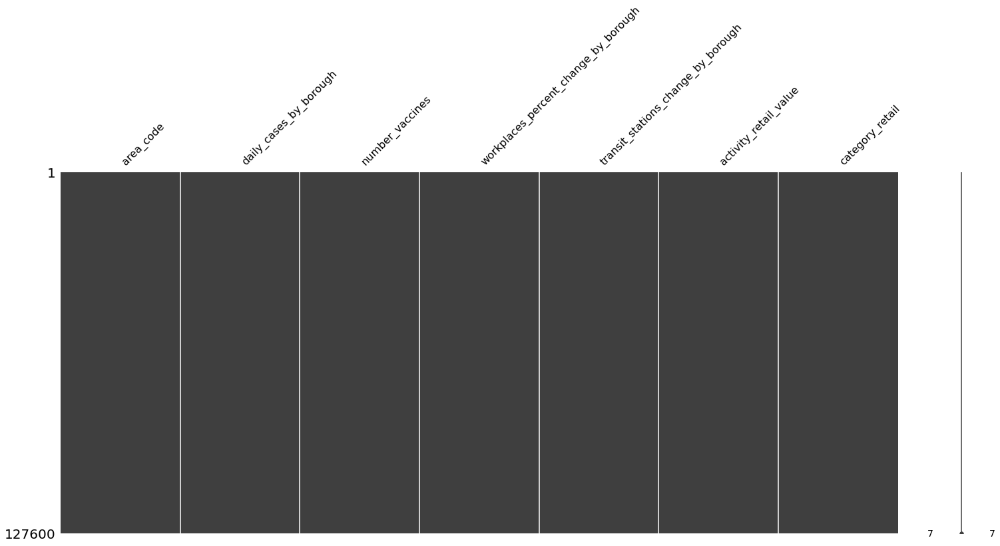

In [ ]:
import missingno as msno

msno.matrix(lon_cov_merge_reg)

### 3.2.2 Method selection

In [ ]:
import warnings
from tqdm import tqdm
from collections import defaultdict

from datetime import datetime
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns 

import sklearn

import matplotlib.pyplot as plt 
import matplotlib.colors as colors
from matplotlib.ticker import MaxNLocator

# seaborn can be used to "prettify" default matplotlib plots by importing and setting as default
sns.set() # Set searborn as default

In [ ]:
with warnings.catch_warnings(): # done to disable all the convergence warnings from elastic net
    warnings.simplefilter("ignore")
    from sklearn.linear_model import LinearRegression,Lasso,Ridge,ElasticNet
    from sklearn.ensemble import RandomForestRegressor

    from sklearn.pipeline import Pipeline
    from sklearn.preprocessing import PolynomialFeatures
    from sklearn.model_selection import GridSearchCV, ShuffleSplit

    from sklearn.metrics import mean_squared_error

In [ ]:
def grid_CV_poly_models(X, Y, poly_degree = 2):
    with warnings.catch_warnings(): # done to disable all the convergence warnings from elastic net
        warnings.simplefilter("ignore")

        #define paramters on wich grid searches
        lasso_params = {'fit__alpha':[0.2,0.5,0.7,1,2,4,5,6,7,8,9,10,11,12,13,14,15,20,30,50,70,100,150,200]}
        ridge_params = {'fit__alpha':[1,10,20,50,70,100,110,120,150,200,250,300]}
        elnet_params = {'fit__max_iter': [1, 5, 10], 'fit__alpha': [0.0001, 0.01, 0.1, 1, 10], 'fit__l1_ratio': [0, 0.001, 1.0, 0.1]}    
        ranfor_params = {'fit__n_estimators': range(10,50), 'fit__max_depth': range(1,11),'fit__max_features': range(3,4,6)}
        elnet_params_ = {'fit__alpha': [0.0001, 0.001, 0.01, 0.1, 1, 10, 100]}    

        #bond togheter basis expansio, paramters and the method that must be used
        #we must add RandomForest and Elastic net

        pipe_OLS = Pipeline([('poly', PolynomialFeatures(degree=2)),
                         ('fit', LinearRegression(normalize=True,fit_intercept=True))])
        pipes = []
        

        pipes.append(Pipeline([('poly', PolynomialFeatures(degree=2)),
                         ('fit', Lasso(normalize=True,fit_intercept=True))]))
        pipes.append(Pipeline([('poly', PolynomialFeatures(degree=2)),
                         ('fit', Ridge(normalize=True,fit_intercept=True))]))
        pipes.append(Pipeline([('poly', PolynomialFeatures(degree=2)),
                         ('fit', ElasticNet(normalize=True,fit_intercept=True))]))
        pipes.append(Pipeline([('fit',RandomForestRegressor(bootstrap=True, oob_score=True,random_state=0))]))


        #fit the models
        models_name=['Lasso', 'Ridge', 'ElasticNet','RandomForest']
        models={'OLS': pipe_OLS}
        scores ={}
        
        for i, params in tqdm(enumerate([lasso_params, ridge_params, elnet_params, ranfor_params]), total = 4, desc="GridSearchCV-iteration"):
            model = GridSearchCV(pipes[i], 
                                  param_grid=params, 
                                  scoring='neg_mean_squared_error').fit(X, Y)
            
            models[models_name[i]] = model.best_estimator_
            
            scores[models_name[i]] = [x for x in model.cv_results_['mean_test_score']]

    return models, scores

In [ ]:
def param_tunning_plot(scores, params, limit=[-5, 80]):
    # Define paramters on which grid searches

    plt.xlim(limit)
    it = 0
    palete = ['b','g','r']

    for k, v in params.items():
        plt.plot(v,[s*-1 for s in scores[k]], f'-o{palete[it]}', label=k)
        it += 1

    plt.legend()
    plt.xlabel('λ')
    plt.ylabel('Mean score')
    plt.rc('figure', figsize=(10, 5))

    plt.show()

In [ ]:
def two_level_CV_Grid_Regress(X, Y, n_splits = 2):
    kf = ShuffleSplit(n_splits=n_splits, test_size=0.3, random_state=0) #order rows at random
    n_splits = kf.get_n_splits(X)

    RMSE = defaultdict(list)

    for i, (train_index, test_index) in tqdm(enumerate(kf.split(X)), total=n_splits, desc="CV-iteration"): # Which split _:_ (?)    
        yTrain, yTest = Y[train_index].ravel() , Y[test_index].ravel() # ravel collapses the array, ie dim(x,1) to (x,)
        XTrain, XTest = X[train_index], X[test_index] # ravel collapses the array, ie dim(x,1) to (x,)


        #print(yTrain.shape, yTest.shape) # Dimensions: 
        #print(XTrain.shape, XTest.shape) # Dimensions:
        
        models,_ = grid_CV_poly_models(X, Y) # Models assesed on the whole data? Or then the prediction would be biased?
        RMSE_i = testRMSE(models,XTrain,yTrain,XTest,yTest) 

        for k, v in RMSE_i.items(): RMSE.setdefault(k,[]).append(RMSE_i[k][0])

    return models, RMSE

In [ ]:
def testRMSE(models, X_train,y_train,X_test,y_test):
    results = {}
    
    for k in models:    
        results[k] = [np.sqrt(mean_squared_error(y_test,
                                               models[k].fit(X_train, 
                                                            y_train).predict(X_test)
                                              )
                           )
                     ]
    return results

Parameter analysis on **one iteration**

In [ ]:
Y = lon_cov_merge_reg['activity_retail_value']
X = lon_cov_merge_reg.drop('activity_retail_value',axis=1)

# (Cv-train & cv-validation) / (Test)    split 
x_train, x_test = X[:70], X[70:] # Dimensions: (70, 122), (30, 122)
y_train, y_test = Y[:70], Y[70:] # Dimensions: (70, ), (30, )

models, scores = grid_CV_poly_models(x_train, y_train)

RMSE_on_one = testRMSE(models,x_train,y_train,x_test,y_test) # check their performance on test set with best parameters

pd.DataFrame.from_dict(RMSE_on_one)

GridSearchCV-iteration: 100%|██████████| 4/4 [01:40<00:00, 25.00s/it]
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 5058.6309078988625, tolerance: 4.756631693885457



,OLS,Lasso,Ridge,ElasticNet_,RandomForest
0,113374.684311,2229.365196,1930.736584,8173.251776,21.023053


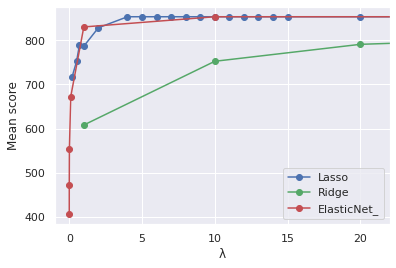

In [ ]:
param_tunning_plot(scores, {'Lasso':[0.2,0.5,0.7,1,2,4,5,6,7,8,9,10,11,12,13,14,15,20,30,50,70,100,150,200],
          'Ridge':[1,10,20,50,70,100,110,120,150,200,250,300],
          'ElasticNet_': [0.0001, 0.001, 0.01, 0.1, 1, 10, 100], 
         }, limit=[-1, 22])

**PARAMETER ANALYSIS on Two-Level Cross Validation**

We see that the regressive methods do not show a good performace compared with **RandomForest**, OLS is the simple regression as a baseline, which for now would be the selected model on one iteration.

Then we apply **base expansion** with **two-level cross validation** in order to assess the CV trained regression appoach improved and select the final model.

In [164]:
models_two_level, RMSE_two_level = two_level_CV_Grid_Regress(X.to_numpy(), Y.to_numpy(), n_splits = 5)

GridSearchCV-iteration: 100%|██████████| 4/4 [1:03:58<00:00, 959.64s/it] 
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 10105795.96919494, tolerance: 4768.9408915586755

/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py:815: UserWarning:

Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable oob estimates.

GridSearchCV-iteration: 100%|██████████| 4/4 [1:04:15<00:00, 963.85s/it] 
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 10172768.157460973, tolerance: 4772.615343309679

/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py:815: UserWarning:

Some inputs do not have OOB scores. This probably mean

In [165]:
pd.DataFrame.from_dict(RMSE_two_level)

,OLS,Lasso,Ridge,ElasticNet,RandomForest
0,14.304158,23.057407,18.492307,15.367800,9.482326
1,14.190706,23.036448,18.441121,15.280059,9.336713
2,14.339112,23.148186,18.537428,15.430812,9.530107
3,14.250382,23.118526,18.479322,15.317096,9.547580
4,14.297408,23.110800,18.500376,15.358499,9.524800


Eventhough Regressions improved, RandomForest is still outperforming. So it is the model we select with their tunned parameters.

 ### 3.2.3. Refit and predict all combinations


In [ ]:
model = models['RandomForest']

model.fit(X, Y)  # Refit

/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py:815: UserWarning:

Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable oob estimates.



Pipeline(memory=None,
         steps=[('fit',
                 RandomForestRegressor(bootstrap=True, ccp_alpha=0.0,
                                       criterion='mse', max_depth=9,
                                       max_features=3, max_leaf_nodes=None,
                                       max_samples=None,
                                       min_impurity_decrease=0.0,
                                       min_impurity_split=None,
                                       min_samples_leaf=1, min_samples_split=2,
                                       min_weight_fraction_leaf=0.0,
                                       n_estimators=21, n_jobs=None,
                                       oob_score=True, random_state=0,
                                       verbose=0, warm_start=False))],
         verbose=False)

All combinations that we want to asses are relative to all boroughs, **all retails** and giving a **range of COVID rate/cases**, meanwhile **fixing workplaces**, **transit** and **vaccinations**. That is:

**Combinations:**

In [ ]:
area_code_mapping.values()

dict_values([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31])

In [ ]:
retail_code_mapping.values()

dict_values([0, 1, 2, 3])

We consider that the COVID **daily_cases_by_borough** in **log2** scale are in the range 0-10, then we consider to have as input for covid cases a **squared transformation of (0,...,100)/10**.

In [ ]:
import numpy as np
np.log2(np.array(lon_cov_merge_reg.daily_cases_by_borough.unique()))[:40]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning:

divide by zero encountered in log2



array([0.        ,       -inf, 2.        , 1.        , 2.32192809,
       3.169925  , 3.32192809, 2.80735492, 3.45943162, 3.5849625 ,
       4.24792751, 4.45943162, 4.70043972, 4.08746284, 3.70043972,
       4.39231742, 3.9068906 , 4.169925  , 3.80735492, 1.5849625 ,
       3.        , 2.5849625 , 4.5849625 , 4.9068906 , 4.52356196,
       4.32192809, 4.64385619, 4.95419631, 5.12928302, 5.64385619,
       5.28540222, 5.4918531 , 5.20945337, 5.9068906 , 5.61470984,
       5.45943162, 5.08746284, 6.04439412, 5.52356196, 6.169925  ])

In [ ]:
cov_cases_range = {n:(n/10)**2 for n in range(0,100)}

Then having the input **daily_cases_by_borough** based on 0-100 scale for the model:

In [ ]:
cov_cases_range.values()

dict_values([0.0, 0.010000000000000002, 0.04000000000000001, 0.09, 0.16000000000000003, 0.25, 0.36, 0.48999999999999994, 0.6400000000000001, 0.81, 1.0, 1.2100000000000002, 1.44, 1.6900000000000002, 1.9599999999999997, 2.25, 2.5600000000000005, 2.8899999999999997, 3.24, 3.61, 4.0, 4.41, 4.840000000000001, 5.289999999999999, 5.76, 6.25, 6.760000000000001, 7.290000000000001, 7.839999999999999, 8.41, 9.0, 9.610000000000001, 10.240000000000002, 10.889999999999999, 11.559999999999999, 12.25, 12.96, 13.690000000000001, 14.44, 15.209999999999999, 16.0, 16.81, 17.64, 18.49, 19.360000000000003, 20.25, 21.159999999999997, 22.090000000000003, 23.04, 24.010000000000005, 25.0, 26.009999999999998, 27.040000000000003, 28.09, 29.160000000000004, 30.25, 31.359999999999996, 32.49, 33.64, 34.81, 36.0, 37.209999999999994, 38.440000000000005, 39.69, 40.96000000000001, 42.25, 43.559999999999995, 44.89, 46.239999999999995, 47.61000000000001, 49.0, 50.41, 51.84, 53.29, 54.760000000000005, 56.25, 57.76, 59.2900

**Fixed values:**

With the last date up-dated indicators, we set staticaly the following entries to simplify the responsive form in the web.

In [ ]:
workplaces_percent_change_by_borough = 32.0
transit_stations_change_by_borough = 58.0
number_vaccines = 4939.0

In [ ]:
X.head(n=3)

,area_code,daily_cases_by_borough,number_vaccines,workplaces_percent_change_by_borough,transit_stations_change_by_borough,category_retail
0,0,1.0,0.0,0.0,3.0,0
1,0,1.0,0.0,0.0,3.0,1
2,0,1.0,0.0,0.0,3.0,2


**Combinations and predict Retail Activity:**

In [ ]:
area_code_name = pd.DataFrame(data={'area_code':lon_cov_merge_4.area_code,
                                    'area_name':lon_cov_merge_4.area_name,
                                    }
                              ).drop_duplicates()


In [ ]:
all_predictions = []

for k_area, v_area in area_code_mapping.items():
    for k_retail, v_retail in retail_code_mapping.items():
        for k_cases, v_cases in cov_cases_range.items():
            all_predictions.append({'area':area_code_name[area_code_name['area_code']==k_area].area_name.values[0],
                                    'retail_type':k_retail.replace('_change_by_borough','').replace('_',' ').capitalize(),
                                    'covid_cases':k_cases,
                                    'retail_activity':model.predict(pd.DataFrame(data={'area_code':[v_area],
                                                                                   'daily_cases_by_borough':[v_cases],
                                                                                   'number_vaccines':[number_vaccines],
                                                                                   'workplaces_percent_change_by_borough':[workplaces_percent_change_by_borough],
                                                                                   'transit_stations_change_by_borough':[transit_stations_change_by_borough],
                                                                                   'category_retail':[v_retail]
                                                                                    }
                                                                            )
                                                                )[0]
                                    }
                                   )

Now the predictions are ready for **the form in the web**.




# 4. Genre. Which genre of data story did you use?

>    The chosen genre is **Comic strip** since it allows us to give an overall visualisation of the whole project. Also, since all visualizations have the same relevance for the project, a non-sequencial genre was best to tell the story of the project. Furhtermore, all the visualization are interactive and allow filtering, details, navigation buttons... plots should be more or less the same size and big enough so all information is clear. 






### 4.1. Which tools did you use from each of the 3 categories of Visual Narrative (Figure 7 in Segal and Heer). Why?


<ul>
<li> Visual structuring: The overall visual structure is a consistent visual platform. All visalizations can be seen in the main view of the webpage. However, some of the plots have a time bar since they show the COVID-19 evolution since the start of the pandemic.</li>
<li> Highlighting: As mentioned previously, the goal of the project is to give an overall view of the impact of the pandemic. All plots have the same importance, highlighting has been barely used. However, feature distincion in the model has been used to draw attention to it, since we believe it is the most interesting feature. </li> 
<li>Transition guidance: As the visual structure is a consistent visual platform no transition tools have been used.
</li>
</ul>


###4.2 Which tools did you use from each of the 3 categories of Narrative Structure (Figure 7 in Segal and Heer). Why?
<ul>
<li>Ordering: A mix between linear path and random access has been used. The webpage is divided in three columns: the first one would be a introductory analysis to the basic stats of the pandemic in London. The column on the middle shows the analysis on socio-economic factors. Lastly, the column on the right summarizes the whole analysis done previously, showing the model and a conclusion. On the top left side of the webpage, a picture of London with an explanatory introduction is displayed. This would be where the user normally starts reading. This way they get an idea of what kind of analysis they are going to read about. On the other hand, on the bottom right part of the webpage, the conclusion is displayed, which would be the last part to read. Apart from the introduction and conclusion, visualization are displayed randomly within their columns, since they are equally important. </li>
<li>Interactivity: Various interactivity tools have been used in the visualizations. In the "CORRELATION COVID INDICATORS AND SOCIAL ACTIVITY", filtering is used. The user can select which variables should be displayed in a darker color. Filtering is used also in the "CHANGE IN ACTIVITY" plot, where a checkbox for each variable is displayed. Navigation buttons are used in the "COVID CASES AND VACCINATIONS", where the point in time to be displayed can be chosen by the user. Navigation buttons are also used in the model to select the COVID level. In the model, a drop-down list to select the neighbourhood has also been used as an interactive tool. Lastly, Explicit instruction is used in the "London map". By placing the mouse on any of the colored areas, the name pf the neghborhood and the percentage of total cases per capita will appear.</li>
<li>Messaging: Lastly, for the messaging, captions and headlines, introductory text and a summary have been used. On the top of the webpage an introduction to the project can be found. Also, for each plot the is an explanatory caption highlighting the most relevant details of each visualization. Lastly, a summary is displayed on the bottom of the webpage</li>
</ul>

## 5. Visualizations

### Explain the visualizations you've chosen.
**Why are they right for the story you want to tell?**

> Diferent kinds of visualisations seen through the course have been used:
*   Linecharts
*   Barcharts
*   Boxplots
*   Maps

> With the following Viz tools:
*   Plotly 
*   Bokeh 
*   D3

## 5.1. Stacked BarChart of COVID-19 cases


In [ ]:
data = lon_cov_merge_4
data.head(n=2)

,area_code,date,daily_cases_by_borough,total_cases_by_borough,age_band,age_lower,age_higher,daily_cases_by_age,population_by_age,age_band_vaccines,dose,number_vaccines,percent_vaccine,area_name,retail_and_recreation_change_by_borough,grocery_and_pharmacy_change_by_borough,transit_stations_change_by_borough,workplaces_percent_change_by_borough,residential_percent_change_by_borough,transit_stations_change,public_transport_change,transport_by_borough,transit_change,transit_by_borough,journeys_change,journeys_by_borough,all_activity_transport_change,workplaces_percent_change_all_london,residential_percent_change_all_london,retail_and_recreation_change,social_change,social_change_by_borough,restaurant_change,restaurant_change_by_borough,grocery_and_pharmacy_change,all_activity_retail_change,median_salary_borough,mean_salary_borough
0,E09000002,2020-03-08,1.0,3.0,0 - 4 years,0.0,4.0,0.0,606004.0,Under 45,0,0.0,0.0,Barking and Dagenham,2.0,9.0,3.0,0.0,0.0,-4.0,-0.276299,-0.723701,0.86,-1.86,-6.0,5.0,-2.354075,-2.46875,2.1875,-1.0,-6.380133,7.380133,-7.0,8.0,3.0,-2.845033,28738.0,32010
1,E09000002,2020-03-08,1.0,3.0,5 - 9 years,5.0,9.0,0.0,602992.0,Under 45,0,0.0,0.0,Barking and Dagenham,2.0,9.0,3.0,0.0,0.0,-4.0,-0.276299,-0.723701,0.86,-1.86,-6.0,5.0,-2.354075,-2.46875,2.1875,-1.0,-6.380133,7.380133,-7.0,8.0,3.0,-2.845033,28738.0,32010


In [ ]:
df_cases=data.groupby(["date"])["daily_cases_by_borough"].sum().reset_index("date")

df_vaccines=data[data["dose"]=="1st dose"].groupby(["date"])["number_vaccines"].sum().reset_index("date")

In [ ]:
df_vaccines_cases = pd.merge(df_cases,df_vaccines,on=['date'],
                            how="outer")
df_vaccines_cases=df_vaccines_cases.fillna(0)

In [ ]:
arr = np.array(df_vaccines_cases["number_vaccines"])
l, h = df_vaccines_cases["daily_cases_by_borough"].min(), df_vaccines_cases["daily_cases_by_borough"].max()
arr=(arr - arr.min()) / (arr.max() - arr.min()) * (h - l) + l
df_vaccines_cases["number_vaccines"]=arr


In [ ]:
df_vaccines_cases.head()

,date,daily_cases_by_borough,number_vaccines
0,2020-03-08,418.0,0.0
1,2020-03-09,988.0,0.0
2,2020-03-10,1748.0,0.0
3,2020-03-11,3477.0,0.0
4,2020-03-12,3116.0,0.0


In [ ]:
vaccines_cases = df_vaccines_cases.to_dict('index')

In [ ]:
from IPython.core.display import display, HTML
display(HTML("<iframe width='120%' height='800' frameborder='0' src='https://observablehq.com/embed/@jmarinllao/stacked-barchart-of-covid-19-cases-vaccinations/2?cells=svg%2Cviewof+date'></iframe> "))

Three waves can be observed in it: The first one from March to mid-June, the second one from September to December and the third one from December to March 2021, when the vaccination plan started being effective. The second and third wave could almost be considered as only just one wave because, as it can be observed in the graph, just a few days after cases started decreasing in December, the increased again, so there was never a stabilization period. In March there is a spike in the number of vaccinations. This was when vaccines were started to be administered. However, this spike does not mean a higher number of vaccines, but a later report on the administered doses. From mid-May, there has been a considerable increase in the vaccination speed, almost reaching 6,500,000 daily doses.

Point out, taking as reference the **plot on 5.3**, that an outlier at the begining of the vaccination period is treated. We supsed that it is due to a collecting error, imputing all cases before the begining of vaccinations date recolletion. Also remind from the merge that since we had weekly reports, we imputed for all days the weekly report.

## 5.2. Stacked Linechart of Social Activity

**RETAIL ACTIVITY** + remotework indicator

In [235]:
all_datasets['activity_retail']['workplaces_percent_change_all_london'] = all_datasets['activity_transport']['workplaces_percent_change_all_london'] 
all_datasets['activity_retail']['residential_percent_change_all_london'] = all_datasets['activity_transport']['residential_percent_change_all_london'] 
all_datasets['activity_retail'].head(n=3)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,retail_and_recreation_change,social_change,retail_social_diff,restaurant_change,retail_restaurants_diff,date,grocery_and_pharmacy_change,all_activity_retail_change,all_area,workplaces_percent_change_all_london,residential_percent_change_all_london
10,-1.0,-6.380133,5.380133,-7.0,6.0,2020-03-08,3.0,-2.845033,E12000007,1.121212,0.03125
11,-3.0,-21.854685,18.854685,-22.0,19.0,2020-03-09,6.0,-10.213671,E12000007,1.393939,0.09375
12,-6.0,-12.029882,6.029882,-23.0,17.0,2020-03-10,7.0,-8.507470,E12000007,0.151515,0.90625


In [236]:
activity_retail_plot = all_datasets['activity_retail'].copy(deep=True)

for col in activity_retail_plot.columns:
    activity_retail_plot[col] = activity_retail_plot[col].astype(str)
    if col == 'date':
        activity_retail_plot[col] = activity_retail_plot[col].str.split(pat='-')
        activity_retail_plot[col] = activity_retail_plot[col].map(lambda x: f'{x[1][1]}/{x[2][1]}/{x[0]}' if x[1][0] == '0' and x[2][0] == '0' else (f'{x[1][1]}/{x[2]}/{x[0]}' if x[1][0] == '0' else (f'{x[1]}/{x[2][1]}/{x[0]}' if x[2][0] == '0' else f'{x[1]}/{x[2]}/{x[0]}')))

    elif col != 'all_area':
        activity_retail_plot[col] = activity_retail_plot[col].str.split(pat=".")
        activity_retail_plot[col] = activity_retail_plot[col].map(lambda x: f'{x[0]}.{x[1][:1]}%' if len(x) > 1 and len(x[1])>2 else f'{x[0]}.0%')


In [238]:
activity_retail_plot.head(n=3)

,retail_and_recreation_change,social_change,retail_social_diff,restaurant_change,retail_restaurants_diff,date,grocery_and_pharmacy_change,all_activity_retail_change,all_area,workplaces_percent_change_all_london,residential_percent_change_all_london
10,-1.0%,-6.3%,5.3%,-7.0%,6.0%,3/8/2020,3.0%,-2.8%,E12000007,1.1%,0.0%
11,-3.0%,-21.8%,18.8%,-22.0%,19.0%,3/9/2020,6.0%,-10.2%,E12000007,1.3%,0.0%
12,-6.0%,-12.0%,6.0%,-23.0%,17.0%,3/10/2020,7.0%,-8.5%,E12000007,0.1%,0.9%


In [ ]:
activity_retail_plot.to_csv('./activityRetailPlot.csv')

In [239]:
from IPython.core.display import display, HTML
display(HTML("<iframe width='120%' height='800' frameborder='0' src='https://observablehq.com/embed/@jmarinllao/untitled/4?cells=chartChange'></iframe> "))

*   Starting from a similar average activity in all sectors, we can see the peaks prior to lockdown in grocery (where the population was supplied by these -especially toilet paper as reported in the media-) and the beginning of the decrease in the rest of the activities. Weekend peaks are also observed, especially in ‘Social’. 
*   A drastic decline in all activities with the imposition of the first lockdown, with the most affected sectors being reservations for restaurants and and ‘social’, and a less drastic change for food and pharmacy products. It is also observed that while during the lockdown the most affected sectors remain stationary with very low activity, as the lockdown progresses if trade in general, both food and recreational, is recovering, remaining with a significantly higher activity. elevated food and basic necessities.
With the lifting of the first lockdown, all sectors are exploring a linear recovery during the summer, but without having recovered the activity of pre-pandemic 'normality', if several points -outliers- are observed, probably due to the holiday periods and back to work. Grocery stores are ahead of the rest of the sector.
*   Given the restrictions applied with the second September wave, the two most punished sectors 'social' and 'restaurant reservations' return to low levels of lockdown, and trade and recreation also fall, while grocery and pharmacist products do not experience in this case any downfall.


**TRANSPORT ACTIVITY** + remotework indicator

In [240]:
all_datasets['activity_transport'].head(n=3)

,transit_stations_change,public_transport_change,transport_stations_diff,transit_change,transit_stations_diff,journeys_change,journeys_stations_diff,date,all_activity_transport_change,all_area,workplaces_percent_change_all_london,residential_percent_change_all_london
0,-4.0,-0.276299,-3.723701,0.86,-4.86,-6.0,2.0,2020-03-08,-2.354075,E12000007,-2.468750,2.187500
1,-6.0,-4.203300,-1.796700,-1.95,-4.05,-3.0,-3.0,2020-03-09,-3.788325,E12000007,-3.937500,1.580645
2,-7.0,-7.378052,0.378052,-0.53,-6.47,-3.0,-4.0,2020-03-10,-4.477013,E12000007,-12.606061,2.281250


In [241]:
activity_transport_plot = all_datasets['activity_transport'].copy(deep=True)

for col in activity_transport_plot.columns:
    activity_transport_plot[col] = activity_transport_plot[col].astype(str)
    if col == 'date':
        activity_transport_plot[col] = activity_transport_plot[col].str.split(pat='-')
        activity_transport_plot[col] = activity_transport_plot[col].map(lambda x: f'{x[1][1]}/{x[2][1]}/{x[0]}' if x[1][0] == '0' and x[2][0] == '0' else (f'{x[1][1]}/{x[2]}/{x[0]}' if x[1][0] == '0' else (f'{x[1]}/{x[2][1]}/{x[0]}' if x[2][0] == '0' else f'{x[1]}/{x[2]}/{x[0]}')))

    elif col != 'all_area':
        activity_transport_plot[col] = activity_transport_plot[col].str.split(pat=".")
        activity_transport_plot[col] = activity_transport_plot[col].map(lambda x: f'{x[0]}.{x[1][:1]}%' if len(x) > 1 and len(x[1])>2 else f'{x[0]}.0%')


In [242]:
activity_transport_plot.head(n=3)

,transit_stations_change,public_transport_change,transport_stations_diff,transit_change,transit_stations_diff,journeys_change,journeys_stations_diff,date,all_activity_transport_change,all_area,workplaces_percent_change_all_london,residential_percent_change_all_london
0,-4.0%,-0.2%,-3.7%,0.8%,-4.8%,-6.0%,2.0%,3/8/2020,-2.3%,E12000007,-2.4%,2.1%
1,-6.0%,-4.2%,-1.7%,-1.9%,-4.0%,-3.0%,-3.0%,3/9/2020,-3.7%,E12000007,-3.9%,1.5%
2,-7.0%,-7.3%,0.3%,-0.5%,-6.4%,-3.0%,-4.0%,3/10/2020,-4.4%,E12000007,-12.6%,2.2%


In [243]:
activity_transport_plot.to_csv('./activityTransportPlot.csv')

In [244]:
from IPython.core.display import display, HTML
display(HTML("<iframe width='120%' height='800' frameborder='0' src='https://observablehq.com/embed/@jmarinllao/untitled/5?cells=viewof+changeCheckbox%2CchartChange'></iframe> "))

The drastic downfall is highlighted in all types of transport. In this case however the trends are more homogeneous than in commercial activity case. All types of transport diminish with the first home lockdown, although they are unmarked during confinement, being the 'Journeys' the most damaged. If it is also observed that the Transit stations stand out above transport by car, probably because it was the type of displacement was made during the confinement for a population sample that does not have a car (not average and for work) . Traffic by car rises with the uprising of the restrictions, imposing over the rest, probably due that many users considered it safer to avoid contagious, despite denoting a global devaluous transit with respect to pre-pandemic levels during this Summer period of normality. With the restrictions applied again in November, a drastic devastation was shown, although with an incidence of greater transit at the levels of the first confinement, probably because in this case they

## 5.3. Stacked Barchart + Linechart of Social Activity in London with COVID-19 cases and Vaccination

This visualization may be considered the central node of the whole project since all relevant dimensions are represented. Here we plotted togheter all the main socio-economical actors studied during our work. Having this visualization as a simple line gives a straightforward view of the fluctuations.
Having it interactively the user can choose the categories that is more interested into and see how they behave during the pandemic.
Moreover to highlight the fact that Cases and vacinations are somehow "different" from the activities, we choose to have them presented as vertical bars.
It's important to notice that the scale of the plot are covid cases. All the other elements are volume ratios scaled according to covid 19 cases.

Collpse **by_borough** Dataset, grouping by date discarting the borough information.

In [245]:
data = lon_cov_merge_4

In [246]:
df_cases=data.groupby(["date"])["daily_cases_by_borough"].sum().reset_index("date")

df_retail=data.groupby(["date"])["retail_and_recreation_change_by_borough"].mean().reset_index("date")

df_retailGP=data.groupby(["date"])["grocery_and_pharmacy_change_by_borough"].mean().reset_index("date")

df_stations=data.groupby(["date"])["transit_stations_change_by_borough"].mean().reset_index("date")

df_workplace=data.groupby(["date"])["workplaces_percent_change_by_borough"].mean().reset_index("date")

df_residential=data.groupby(["date"])["residential_percent_change_by_borough"].mean().reset_index("date")

df_vaccines=data[data["dose"]=="1st dose"].groupby(["date"])["number_vaccines"].sum().reset_index("date")

In [247]:
df_vaccines= df_vaccines.iloc[1:].reset_index()
df_retail['cases'] = pd.Series(df_cases["daily_cases_by_borough"], index=df_retail.index)
df=df_retail

df["date"]= pd.to_datetime(df["date"], format='%Y/%m/%d')
df["retail_and_recreation"]=df["retail_and_recreation_change_by_borough"].astype(int)
df["cases"]=df["cases"].astype(int)
df["grocery_and_pharmacy"]=df_retailGP["grocery_and_pharmacy_change_by_borough"].astype(int)
df["transit_stations"]=df_stations["transit_stations_change_by_borough"].astype(int)
df["workplaces"]=df_workplace["workplaces_percent_change_by_borough"].astype(int)
df["residential"]=df_residential["residential_percent_change_by_borough"].astype(int)

df=df.drop("retail_and_recreation_change_by_borough",1)
df=df.fillna(0)

In [248]:
arr = np.array(df["retail_and_recreation"])
l, h = df["cases"].min(), df["cases"].max()
arr=(arr - arr.min()) / (arr.max() - arr.min()) * (h - l) + l
df["retail_and_recreation"]=arr

arr = np.array(df["grocery_and_pharmacy"])
l, h = df["cases"].min(), df["cases"].max()
arr=(arr - arr.min()) / (arr.max() - arr.min()) * (h - l) + l
df["grocery_and_pharmacy"]=arr

arr = np.array(df["transit_stations"])
l, h = df["cases"].min(), df["cases"].max()
arr=(arr - arr.min()) / (arr.max() - arr.min()) * (h - l) + l
df["transit_stations"]=arr

arr = np.array(df["workplaces"])
l, h = df["cases"].min(), df["cases"].max()
arr=(arr - arr.min()) / (arr.max() - arr.min()) * (h - l) + l
df["workplaces"]=arr

arr = np.array(df["residential"])
l, h = df["cases"].min(), df["cases"].max()
arr=(arr - arr.min()) / (arr.max() - arr.min()) * (h - l) + l
df["residential"]=arr

arr = np.array(df_vaccines["number_vaccines"])
l, h = df["cases"].min(), df["cases"].max()
arr=(arr - arr.min()) / (arr.max() - arr.min()) * (h - l) + l
df_vaccines["number_vaccines"]=arr

a=np.append(np.zeros(352),df_vaccines["number_vaccines"].astype(int).values)
len(a)

df["vaccines"]=a


In [249]:
from bokeh.models import ColumnDataSource, FactorRange
from bokeh.plotting import figure, output_file, show
from bokeh.palettes import turbo
from bokeh.io import push_notebook, show, output_notebook
output_notebook()
from bokeh.models import BoxAnnotation, ColumnDataSource

#first lockdown
box_left1 = pd.to_datetime('2020-3-16')
box_right1 = pd.to_datetime('2020-6-1')

#second lockdown
box_left2 = pd.to_datetime('2020-11-5')
box_right2 = pd.to_datetime('2020-12-2')

#second lockdown
box_left3 = pd.to_datetime('2020-12-21')
box_right3 = pd.to_datetime('2021-3-08')

source = ColumnDataSource(df)

In [250]:
from bokeh.plotting import figure

p = figure(x_axis_type='datetime',width=1000)


p.line(x="date", y="retail_and_recreation", color='red',line_width=2, legend_label='Retail & Social Activities volume',source=source, muted_alpha=0.1, muted =True)
p.line(x="date", y="grocery_and_pharmacy", color='green',line_width=2, legend_label='Grocery & Pharmacies affairs volume',source=source, muted_alpha=0.1, muted =False)
p.line(x="date", y="transit_stations", color='brown', line_width=2,legend_label='Train stations customer volume',source=source, muted_alpha=0.1, muted =True)
p.line(x="date", y="residential", color='black',line_width=2, legend_label='People working from home',source=source, muted_alpha=0.1, muted =True)
p.vbar(x="date", top="cases", width=10, legend_label='Daily cases of covid 19',source=source, muted_alpha=0.4, muted =False)
p.vbar(x="date", top="vaccines", width=10,color='yellow', legend_label='Vaccinations 1st dose (weekly updated)',source=source, muted_alpha=0.4, muted =False)


p.xaxis.axis_label = 'Date'
p.x_range.range_padding = 0.2

In [251]:
box = BoxAnnotation(left=box_left1, right=box_right1,
                    line_width=1, line_color='black', line_dash='dashed',
                    fill_alpha=0.2, fill_color='orange')

box2 = BoxAnnotation(left=box_left2, right=box_right2,
                    line_width=1, line_color='black', line_dash='dashed',
                    fill_alpha=0.2, fill_color='orange')

box3 = BoxAnnotation(left=box_left3, right=box_right3,
                    line_width=1, line_color='black', line_dash='dashed',
                    fill_alpha=0.2, fill_color='orange')

p.add_layout(box)
p.add_layout(box2)
p.add_layout(box3)

In [262]:
from bokeh.io import output_notebook, show

output_notebook()

p.legend.click_policy = 'mute' 
p.legend.location = "top_left"
p.left[0].formatter.use_scientific = False


Check web for the output (last section).

In [263]:
show(p)

## 5.4 Map of COVID-19 cases per capita by area 

First, we need a list with the code for each London's area to plot the city map

In [253]:
london = json.load(open("london_boroughs.json", 'r'))
mapping = {}

for feature in london['features']:
    feature['id'] = feature['properties']['code']
    mapping[feature['properties']['name']] = feature['id']

Now, we need to calculate the percentage of total cases

In [254]:
borough_profiles = pd.read_excel("london-borough-profiles.xlsx", sheet_name='Data')
borough_profiles = borough_profiles.rename(columns = {'GLA Population Estimate 2017' : 'population', 'Code' : 'area_code'})
pop = borough_profiles.groupby(['area_code'],as_index=False).population.sum()
pop = pop.drop(range(0,5),axis=0)
lon_cov_merge_4 = pd.merge(lon_cov_merge_4, pop)
lon_cov_merge_4['percentage'] = (lon_cov_merge_4['total_cases_by_borough']/lon_cov_merge_4['population'])*100

Lastly, we plot the map with the percentages

In [255]:
fig = px.choropleth_mapbox(lon_cov_merge_4, locations='area_code', geojson=london,  color='percentage', 
                           color_continuous_scale="agsunset",
                           range_color=(lon_cov_merge_4["percentage"].min(), lon_cov_merge_4["percentage"].max()),
                           mapbox_style="carto-positron",
                           zoom=9, center = {"lat": 51.506949, "lon":-0.122876},
                           opacity=0.5,
                           labels={'area_name':'Borough', 'new_cases ':'Total amount of cases' }
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [256]:
df_cases=data.groupby(["date"])["daily_cases_by_borough"].sum().reset_index("date")

df_vaccines=data[data["dose"]=="1st dose"].groupby(["date"])["number_vaccines"].sum().reset_index("date")##By activity, not right
fig = px.choropleth_mapbox(lon_cov_merge_4, locations='area_code', geojson=london,  color='all_activity_retail_change', 
                           color_continuous_scale="agsunset",
                           range_color=(lon_cov_merge_4["all_activity_retail_change"].min(), lon_cov_merge_4["all_activity_retail_change"].max()),
                           mapbox_style="carto-positron",
                           zoom=9, center = {"lat": 51.506949, "lon":-0.122876},
                           opacity=0.5,
                           labels={'area_name':'Borough', 'all_activity_retail_change ':'Activity' }
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

This map shows the percentage of total cases per capita during the whole pandemic. The brighter the color shade gets, the higher cases the area has had. For all areas, the percentage of the total number of cases varies from 5,5% to 11.5%. In section 2, it was mentioned that the absolute number of cases in the city center had been lower than in other areas. The suggested hypothesis to explain this fact was that population density was lower in the city center due to housing prices. However, from this plot, we can see how the percentage of infected people in the central areas is still lower than in the outskirts of the city. The data indicates that in the areas south of London city center, the trend of cases is lower, contrary to the upper areas. In order to say anything qualified of the reasioning, supplementary data would be needed. This could be information on for instance, job types since an office worker potentially can work from home, whereas a production worker must be physically present. Another factor could be ethnical backgrounds and family relations.

## 5.5 Customizable selection results on predicted **LinReg** -> **ActivityRetailValue**

With all the computed values from refited regressive model in **point 3.2.3** we restructure them in order to have an interactive view based on the selection of **area** and **covid_cases** tranformed rate. 

Such transformation was done due to a **user interaction consideration**, since we thought could be easier for the user to work in a 0-100 scale for COVID cases than on number of cases, also because a normalization reason, since the cases are either few or large amounts.

In [257]:
pd.DataFrame.from_dict(all_predictions)

,area,retail_type,covid_cases,retail_activity
0,Barking and Dagenham,Retail and recreation,0,86.178166
1,Barking and Dagenham,Retail and recreation,1,86.178166
2,Barking and Dagenham,Retail and recreation,2,86.178166
3,Barking and Dagenham,Retail and recreation,3,86.178166
4,Barking and Dagenham,Retail and recreation,4,86.178166
...,...,...,...,...
12795,Westminster,Restaurant,95,94.162984
12796,Westminster,Restaurant,96,94.162984
12797,Westminster,Restaurant,97,94.162984
12798,Westminster,Restaurant,98,94.162984


In [258]:
pd.DataFrame.from_dict(all_predictions).area.unique()

array(['Barking and Dagenham', 'Barnet', 'Bexley', 'Brent', 'Bromley',
       'Camden', 'Croydon', 'Ealing', 'Enfield', 'Greenwich', 'Hackney',
       'Hammersmith and Fulham', 'Haringey', 'Harrow', 'Havering',
       'Hillingdon', 'Hounslow', 'Islington', 'Kensington and Chelsea',
       'Kingston upon Thames', 'Lambeth', 'Lewisham', 'Merton', 'Newham',
       'Redbridge', 'Richmond upon Thames', 'Southwark', 'Sutton',
       'Tower Hamlets', 'Waltham Forest', 'Wandsworth', 'Westminster'],
      dtype=object)

In [259]:
import json
with open('lon_cov_predictions.json', 'w') as f:
    json.dump(pd.DataFrame.from_dict(all_predictions).to_dict('records'), f)

In [264]:
from IPython.core.display import display, HTML
display(HTML("<iframe width='120%' height='800' frameborder='0' src='https://observablehq.com/embed/@jmarinllao/flu-mcv?cells=viewof+barchart%2Cviewof+weekSlider'></iframe> "))

Now the predictions are ready for **the form in the web**.

This model calculates the performance of “Grocery and pharmacy”, “Social”, “Restaurant” and “Restaurant and recreation” according to a COVID level. The COVID level is given by the number of daily cases and vaccines administered. The lower the daily cases and the higher the vaccines doses are, the lower the COVID level will be.  In the dropdown list, a neighbourhood can be selected and the performance for each business will be calculated for that specific neighbourhood. It is interesting to note that, no matter the neighbourhood or COVID level, the performance of groceries and pharmacy remains almost in 100 for all neighbourhoods. Contrary to this, retail and recreation seems to be the kind of business with most difficulties to recover, since even with the lowest COVID level, remains only around 80 for all neighbourhoods. On the other hand, social and restaurants are the ones that varies the most depending on COVID level. These variations are mainly due to restrictions. The higher the COVID cases are, the stricter the restrictions get. Restrictions affect differently to each kind of businesses. Groceries and pharmacies are not affected by restrictions they can remain open even during the lockdowns. As for retail, it is affected by restrictions but there is still the option for online shopping, so it makes sense that the performance does not change that much according to COVID level. Lastly, restaurants and social are the most affected by restrictions and, therefore by COVID level, since the need to be closed down when high COVID levels.




# 6.Discussion. Think critically about your creation


## 6.1. What went well?
We have managed to deliver a webpage with many interactive plots that can be used to understand the socio-economical impact of COVID-19 in London. We had to do some research on how to include these interactive plots, since at the beginning we only knew how to display non-interactive visualizations.
\
Also, since we chose 7 different datasets we had to merge all these datasets together which was harder than expected. However, we were able to do so and get a final database with all the data needed for the project.

## 6.2. What is still missing? What could be improved?, Why?
The preprocessing of the data took much longer than expected, evethought that, we considered we achieved all the proposed, just leaving left some minor additions and/or refines such as: 


*   Further feature selection on the web's form (i.e. transportation) based on the regressive model.
*   Stratified plots by neighbourhoods or by age bands.
*   Forecast model on COVID cases. We aimed at the start to implement a forecast model on pandemic trends and/or on activiy records. Nevertheless, due to fact that not enough information on the virus is provided, since it results mostly influenced by restrictions imposed by governments and the spreading rates, like the RT factor, we excluded the possibility and foucused on the no-date time approach. It could be a good continuty point.

Also note that we had some issues with the data availability. For instance, for the activity data, there were only values up to February 2021, so we had to find a different database that contained all the missing values and merge it with the previous one.

## 7. Contributions. Who did what?



AC: Webpage developement and deployment. Exploratory analysis. Model. Plots on relation between COVID-19 and socio-economical activity
\
JM: Webpage developement and deployment. Preprocessing. Model. Plots on socio-economical activity
\
AT: Preprocessing. Exploratory writing in notebook. Map and COVID cases and vaccination plots.

## 8. References 


Datastore, L. (2021). London Datastore . Obtained from London Datastore.

